# Explore Predictions 

In [1]:
# import the VAE code
import sys
from buddi import buddi
from buddi.preprocessing import sc_preprocess
from buddi.plotting import validation_plotting as vp


# general imports

import warnings
import numpy as np
import scanpy as sc
import anndata as ad
import scipy


# Images, plots, display, and visualization
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import scale, MinMaxScaler
from matplotlib_venn import venn2
from upsetplot import from_contents, UpSet

# programming stuff
import time
import os
import pickle
from pathlib import Path

# tensorflow stuff
import tensorflow as tf
from tensorflow.keras.optimizers.legacy import Adam
from tensorflow.keras.utils import to_categorical, normalize, plot_model

# prediction stuff

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_recall_curve, classification_report,f1_score,PrecisionRecallDisplay
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import accuracy_score, mean_squared_error



# disable eager execution
# https://github.com/tensorflow/tensorflow/issues/47311#issuecomment-786116401
from tensorflow.python.framework.ops import disable_eager_execution
disable_eager_execution()


2025-06-25 14:15:20.905786: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-06-25 14:15:20.924585: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-06-25 14:15:21.120720: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-06-25 14:15:21.293937: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750882521.430454  346315 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750882521.47

In [2]:
## parameters
consensus_ov_gene_path = f"{os.getcwd()}/../../data/consensusOV_genes.csv"
consensus_ov_ex_path = f"{os.getcwd()}/../../data/bulk/schW_example_scores.tsv"
consensus_ov_ex_df = pd.read_csv(consensus_ov_ex_path, sep="\t")


exp_id = "all-cellType"
res_id = "cellType" # cellType subtype celltype_granular

curr_treatment = "drug"


pseudobulk_ids = ["GSE192898", "GSE154600", "GSE180661", "GSE217517", "GSE165897"]

tumor_cell_ids = ['Tumor_cell', "Epithelial cells", "Ovarian.cancer.cell",
                  "EOC"]

immune_cell_ids = ['B-cell', 'CD4+_T-cell',  'CD8+_T-cell', 'Macrophage',
                    'Monocyte', 'NK_cell', "CD8+ T-cells", "Macrophages", "Monocytes", 
                    "NK cells", "CD4+ T-cells", "B-cells",
                    "T.cell", "Monocyte", "B.cell", "Immune"]
stromal_cell_ids = ['Endothelial_cell', 'Fibroblast', "Endothelial cells", 
                  "Adipocytes", "Mesangial cells",
                  "Fibroblasts", "Endothelial.cell", "Stromal"]



In [3]:
# load each pseudobulk

all_adata = None
for curr_pseudobulk_id in pseudobulk_ids:

    # set file names
    sc_aug_data_path = f"{os.getcwd()}/../../data/single_cell/{curr_pseudobulk_id}_pseudobulks/"
    in_ad_file = f"{sc_aug_data_path}/{exp_id}.h5ad"
    subtype_file = f"{sc_aug_data_path}/{exp_id}_subtypes.tsv"

    # read
    adata = sc.read_h5ad(in_ad_file)
    subtype_df = pd.read_csv(subtype_file, sep="\t")

    # append to obs they should be in exactly the same order
    subtype_df.index = adata.obs.index
    adata.obs = pd.concat([adata.obs, subtype_df], axis=1)

    # make cell type annotations
    if curr_pseudobulk_id == "GSE192898":
        cell_types = ['B-cell',
                        'CD4+_T-cell',
                        'CD8+_T-cell',
                        'Endothelial_cell',
                        'Fibroblast',
                        'Macrophage',
                        'Monocyte',
                        'NK_cell',
                        'Tumor_cell']
        tumor_ref = "Tumor_cell"
        stromal_ref = 'Fibroblast'
        immune_ref = 'Monocyte'
    elif curr_pseudobulk_id == "GSE154600":
        cell_types = ["CD8+ T-cells", "Macrophages", "Monocytes", 
                  "NK cells", "CD4+ T-cells", "B-cells", "Endothelial cells", 
                  "Adipocytes", "Mesangial cells",
                  "Fibroblasts", "Epithelial cells"]
        tumor_ref = "Epithelial cells"
        stromal_ref = 'Fibroblasts'
        immune_ref = 'Monocytes'
    elif curr_pseudobulk_id == "GSE180661":
        cell_types = ["T.cell", "Ovarian.cancer.cell", "Fibroblast", 
                  "Monocyte", "B.cell", "Endothelial.cell", 
                  "Plasma.cell"]
        tumor_ref = "Ovarian.cancer.cell"
        stromal_ref = 'Fibroblast'
        immune_ref = 'Monocyte'
    elif curr_pseudobulk_id == "GSE217517":
        cell_types = ["B cells", "DC", "Macrophages", 
                "Mast cells", "Monocytes", "NK cells", "Plasma cells",
                "T cells", "Endothelial cells", "Fibroblasts",
                "Epithelial cells"]
        tumor_ref = "Epithelial cells"
        stromal_ref = 'Fibroblasts'
        immune_ref = 'Monocytes'
    elif curr_pseudobulk_id == "GSE165897":
        cell_types = ["EOC", "Stromal", "Immune"]
        tumor_ref = "EOC"
        stromal_ref = 'Stromal'
        immune_ref = 'Immune'
        

    Y_full = adata.obs[cell_types]
    Y_max = np.copy(Y_full)
    Y_max = np.argmax(Y_max, axis=1)
    Y_max = Y_full.columns[Y_max]
    adata.obs["Y_max"] = Y_max

    adata.obs["GSE_ID"] = curr_pseudobulk_id

    adata.obs["tumor_ref_prop"] = adata.obs[tumor_ref]
    adata.obs["immune_ref_prop"] = adata.obs[immune_ref]
    adata.obs["stromal_ref_prop"] = adata.obs[stromal_ref]

    # append
    if all_adata is None:
        all_adata = adata
    else:
        all_adata = ad.concat([all_adata, adata])


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  uti

In [4]:
all_adata

AnnData object with n_obs × n_vars = 97500 × 17657
    obs: 'sample_id', 'stim', 'isTraining', 'cell_prop_type', 'samp_type', 'IMR_consensus', 'DIF_consensus', 'PRO_consensus', 'MES_consensus', 'subtype', 'Y_max', 'GSE_ID', 'tumor_ref_prop', 'immune_ref_prop', 'stromal_ref_prop'

In [5]:
all_adata.obs

,sample_id,stim,isTraining,cell_prop_type,samp_type,IMR_consensus,DIF_consensus,PRO_consensus,MES_consensus,subtype,Y_max,GSE_ID,tumor_ref_prop,immune_ref_prop,stromal_ref_prop
0,ovCHA004,CTRL,Train,random,sc_ref,0.028,0.012,0.102,0.858,MES,Endothelial_cell,GSE192898,0.025000,0.220000,0.145000
1,ovCHA004,CTRL,Train,random,sc_ref,0.042,0.072,0.168,0.718,MES,Endothelial_cell,GSE192898,0.070000,0.030000,0.190000
2,ovCHA004,CTRL,Train,random,sc_ref,0.044,0.438,0.286,0.232,DIF,Tumor_cell,GSE192898,0.255000,0.045000,0.030000
3,ovCHA004,CTRL,Train,random,sc_ref,0.256,0.056,0.054,0.634,MES,CD8+_T-cell,GSE192898,0.005000,0.005000,0.090000
4,ovCHA004,CTRL,Train,random,sc_ref,0.096,0.216,0.104,0.584,MES,Endothelial_cell,GSE192898,0.065000,0.210000,0.050000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27295,Samp_EOC227_primary_Omentum,CTRL,Train,cell_type_specific,sc_ref,0.646,0.170,0.028,0.156,IMR,Immune,GSE165897,0.005279,0.924412,0.070310
27296,Samp_EOC227_primary_Omentum,CTRL,Train,cell_type_specific,sc_ref,0.750,0.114,0.028,0.108,IMR,Immune,GSE165897,0.006093,0.991603,0.002303
27297,Samp_EOC227_primary_Omentum,CTRL,Train,cell_type_specific,sc_ref,0.728,0.176,0.026,0.070,IMR,Immune,GSE165897,0.010740,0.975358,0.013902
27298,Samp_EOC227_primary_Omentum,CTRL,Train,cell_type_specific,sc_ref,0.766,0.104,0.054,0.076,IMR,Immune,GSE165897,0.001283,0.994742,0.003975


In [6]:

def plot_scores_props(in_df, samp_id, axs):

    # immune row
    in_df = all_adata.obs.iloc[np.where(all_adata.obs.sample_id == samp_id)[0]]
    x_vec = ["immune_ref_prop", "stromal_ref_prop", "tumor_ref_prop"]

    y_str = "IMR_consensus"
    sns.regplot(data=in_df, x=x_vec[0], y=y_str, ax=axs[0, 0], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[1], y=y_str, ax=axs[0, 1], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[2], y=y_str, ax=axs[0, 2], scatter_kws={'alpha':0.3})

    y_str = "MES_consensus"
    sns.regplot(data=in_df, x=x_vec[0], y=y_str, ax=axs[1, 0], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[1], y=y_str, ax=axs[1, 1], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[2], y=y_str, ax=axs[1, 2], scatter_kws={'alpha':0.3})

    y_str = "DIF_consensus"
    sns.regplot(data=in_df, x=x_vec[0], y=y_str, ax=axs[2, 0], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[1], y=y_str, ax=axs[2, 1], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[2], y=y_str, ax=axs[2, 2], scatter_kws={'alpha':0.3})

    y_str = "PRO_consensus"
    sns.regplot(data=in_df, x=x_vec[0], y=y_str, ax=axs[3, 0], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[1], y=y_str, ax=axs[3, 1], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[2], y=y_str, ax=axs[3, 2], scatter_kws={'alpha':0.3})

    for ax in axs.flat:
        ax.set_xlim(0, 1)
        ax.set_ylim(0, 1)


    return(axs)


def plot_scores_props_tumor(in_df, samp_id, axs):

    # immune row
    in_df = all_adata.obs.iloc[np.where(all_adata.obs.sample_id == samp_id)[0]]
    x_vec = ["tumor_ref_prop"]

    y_str = "IMR_consensus"
    sns.regplot(data=in_df, x=x_vec[0], y="DIF_consensus", ax=axs[0], scatter_kws={'alpha':0.3})
    sns.regplot(data=in_df, x=x_vec[0], y="PRO_consensus", ax=axs[1], scatter_kws={'alpha':0.3})

    for ax in axs.flat:
        ax.set_xlim(0, 1)
        ax.set_ylim(0, 1)


    return(axs)



# looking at GSE180661

/tmp/ipykernel_346315/850256933.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  in_df["prop_max"].iloc[np.where(in_df.immune_ref_prop > 0.9)] = "immune"
/tmp/ipykernel_346315/850256933.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  in_df["prop_max"].iloc[np.where(in_df.tumor_ref_prop > 0.9)] = "tumor_DIF"
/tmp/ipykernel_346315/850256933.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  in_df["prop_max"].iloc[np.where(in_df.s

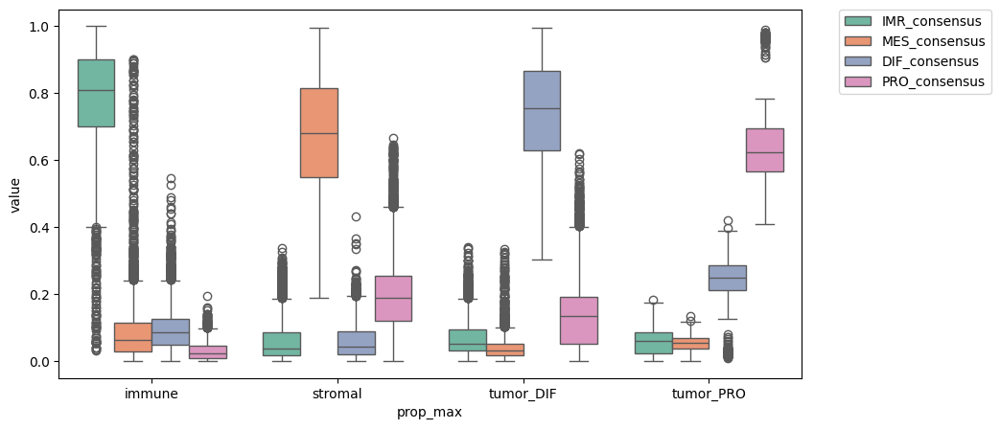

In [7]:
in_df = all_adata.obs
in_df["prop_max"] = "mid"
in_df["prop_max"].iloc[np.where(in_df.immune_ref_prop > 0.9)] = "immune"
in_df["prop_max"].iloc[np.where(in_df.tumor_ref_prop > 0.9)] = "tumor_DIF"
in_df["prop_max"].iloc[np.where(in_df.stromal_ref_prop > 0.9)] = "stromal"

pro_samps = ["SPECTRUM-OV-065_S1_INFRACOLIC_OMENTUM", "SPECTRUM-OV-083_S1_INFRACOLIC_OMENTUM",
             "Samp_EOC153_primary_Omentum", "Samp_EOC372_primary_Peritoneum", "ovCHA070", "Samp_2497"]
in_df["prop_max"].iloc[np.where(np.logical_and(in_df.sample_id.isin(pro_samps),
                                               in_df.tumor_ref_prop > 0.9))] = "tumor_PRO"


in_df = in_df.loc[in_df.prop_max != "mid"]

in_df = in_df[["IMR_consensus", "DIF_consensus", "PRO_consensus", "MES_consensus", "prop_max"]]
in_df["id"] = range(in_df.shape[0])


in_df = pd.melt(in_df, id_vars=['id', "prop_max"], value_vars=["IMR_consensus",  "MES_consensus", "DIF_consensus", "PRO_consensus",])

with rc_context({'figure.figsize': (10, 5)}):
    sns.boxplot(x='prop_max', y='value', hue='variable', data=in_df,
                order = ["immune", "stromal", "tumor_DIF", "tumor_PRO"])
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)


In [8]:

in_ov_df = consensus_ov_ex_df.copy()

in_ov_df["id"] = range(in_ov_df.shape[0])
in_ov_df['consensusOV.subtypes'] = in_ov_df['consensusOV.subtypes'].str.replace('_consensus', '')

in_ov_df = in_ov_df[["IMR_consensus", "DIF_consensus", "PRO_consensus", "MES_consensus", "consensusOV.subtypes", "id"]]
in_ov_df = pd.melt(in_ov_df, id_vars=['id', "consensusOV.subtypes"], value_vars=["IMR_consensus",  "MES_consensus", "DIF_consensus", "PRO_consensus",])

with rc_context({'figure.figsize': (10, 5)}):
    sns.boxplot(x='consensusOV.subtypes', y='value', hue='variable', data=in_ov_df,
                order = ["IMR", "MES", "DIF", "PRO"])
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

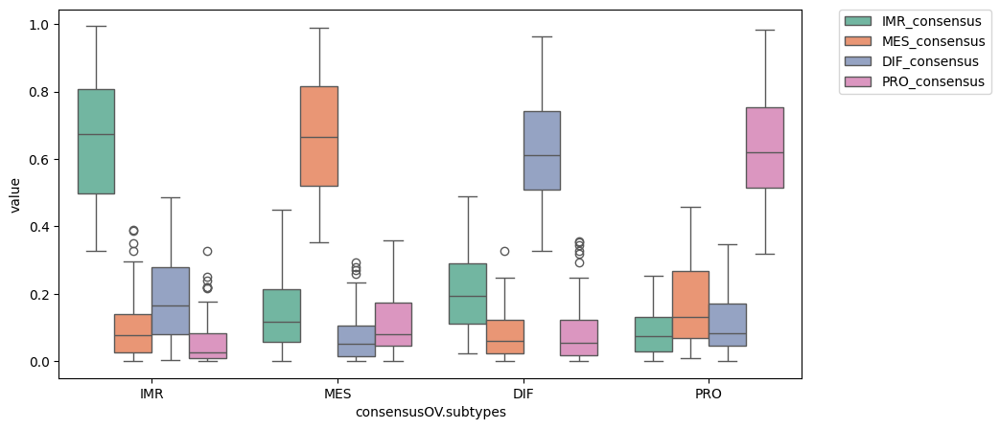

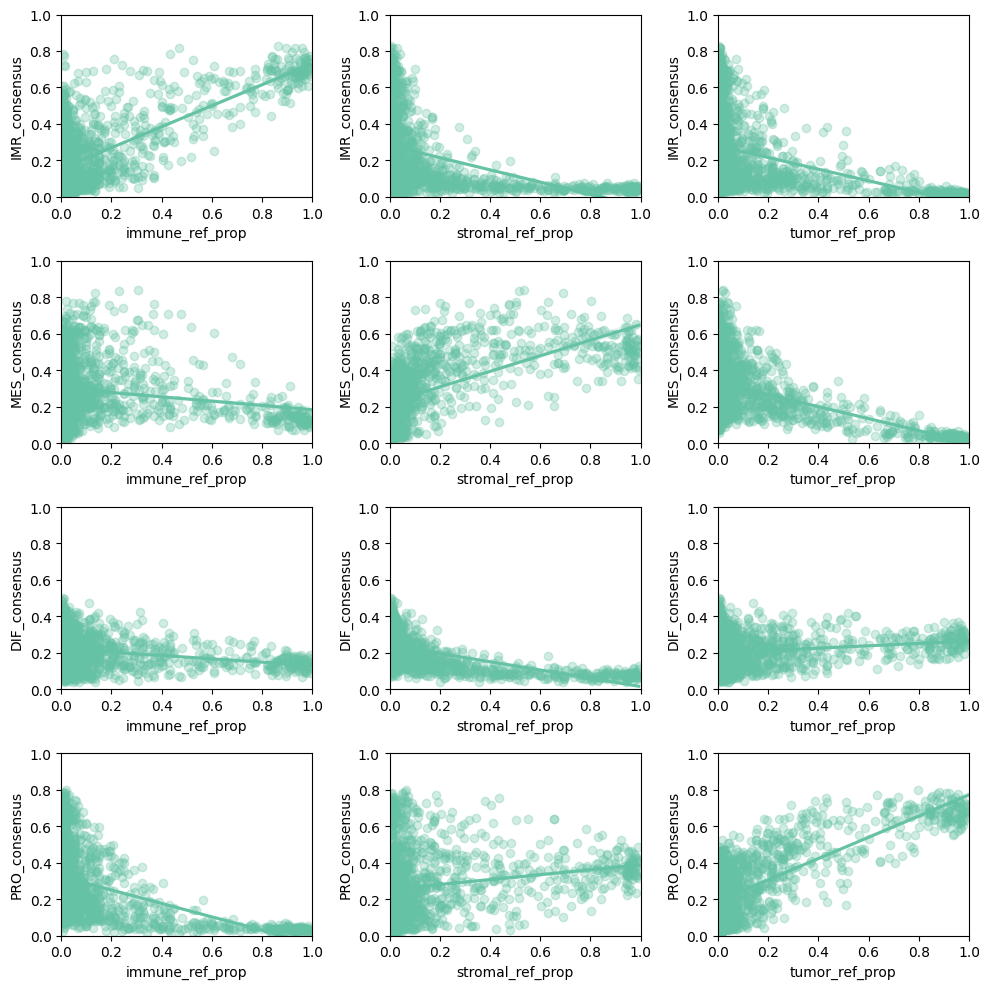

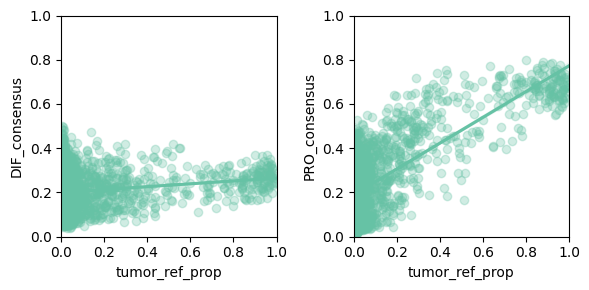

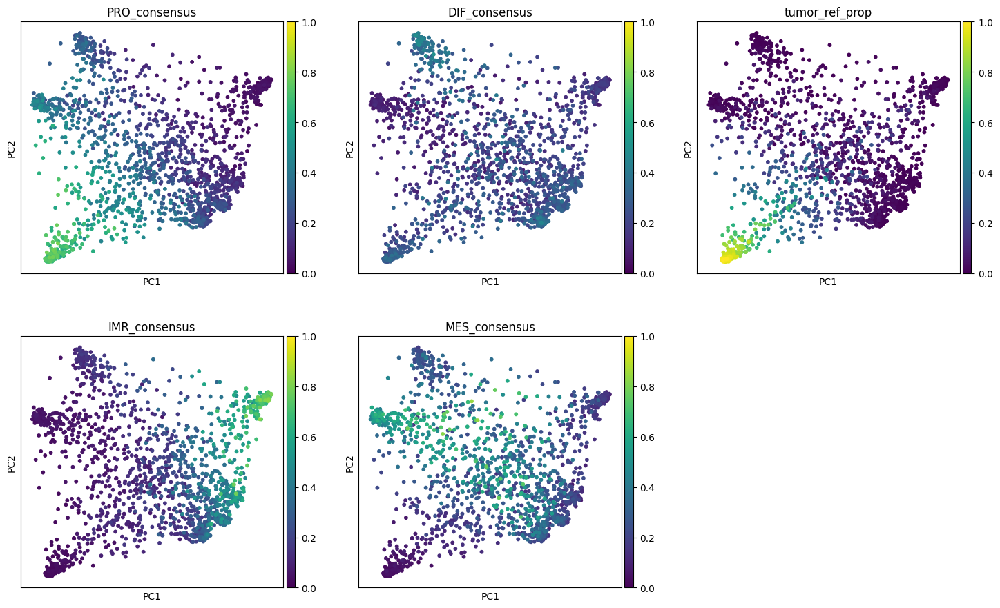

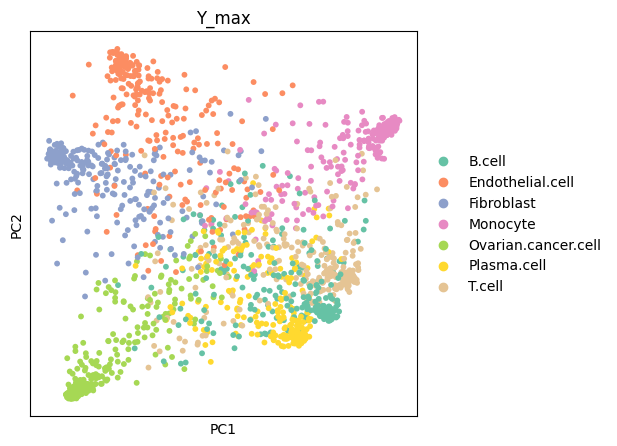

In [9]:
# Proliferative

samp_id = "SPECTRUM-OV-065_S1_INFRACOLIC_OMENTUM"

fig, axs = plt.subplots(4, 3, figsize=(10, 10))
axs = plot_scores_props(in_df=all_adata.obs, samp_id=samp_id, axs=axs)

plt.xlim(0, 1)
plt.ylim(0, 1)
fig.tight_layout()


fig, axs = plt.subplots(1, 2, figsize=(6, 3))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)



/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

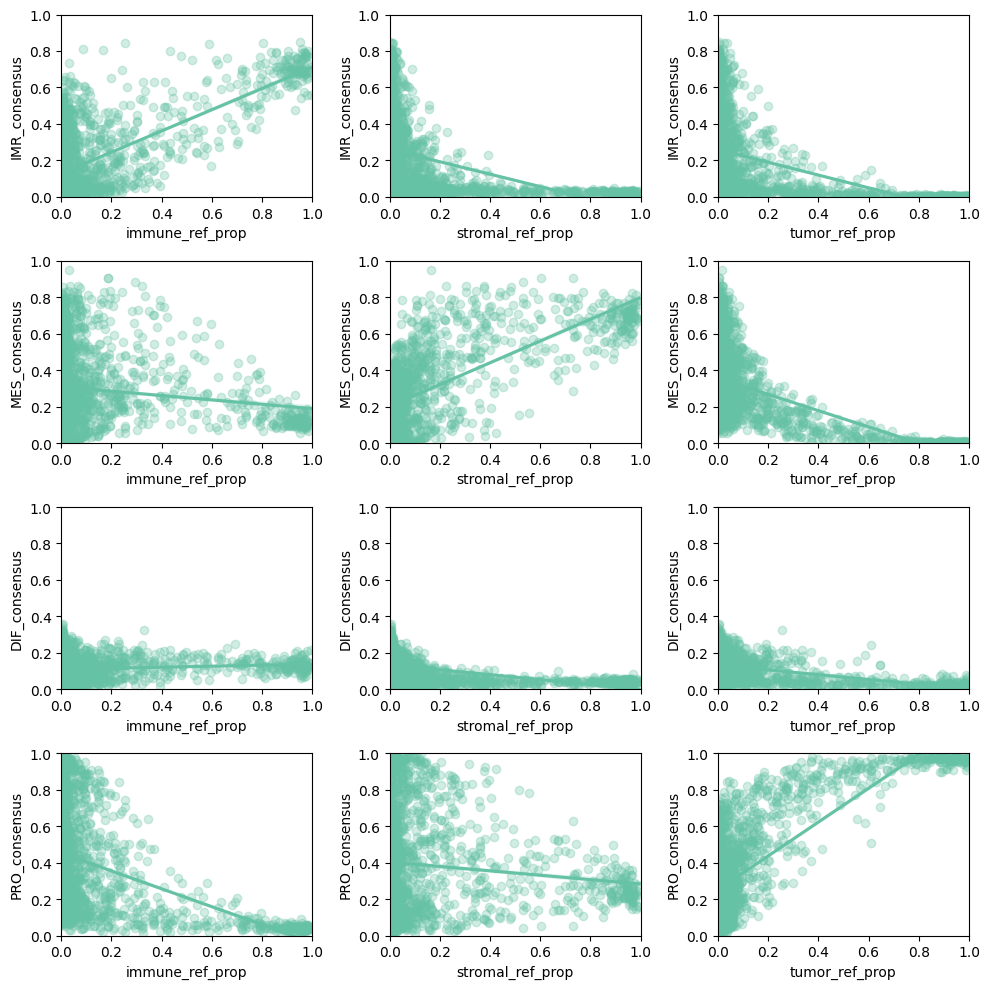

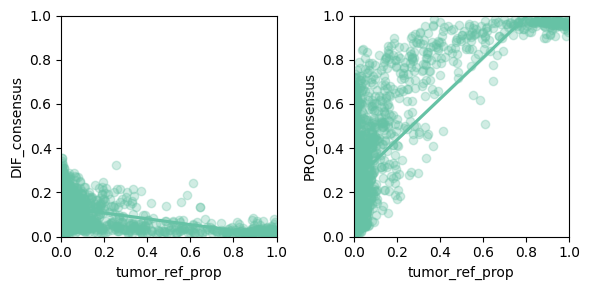

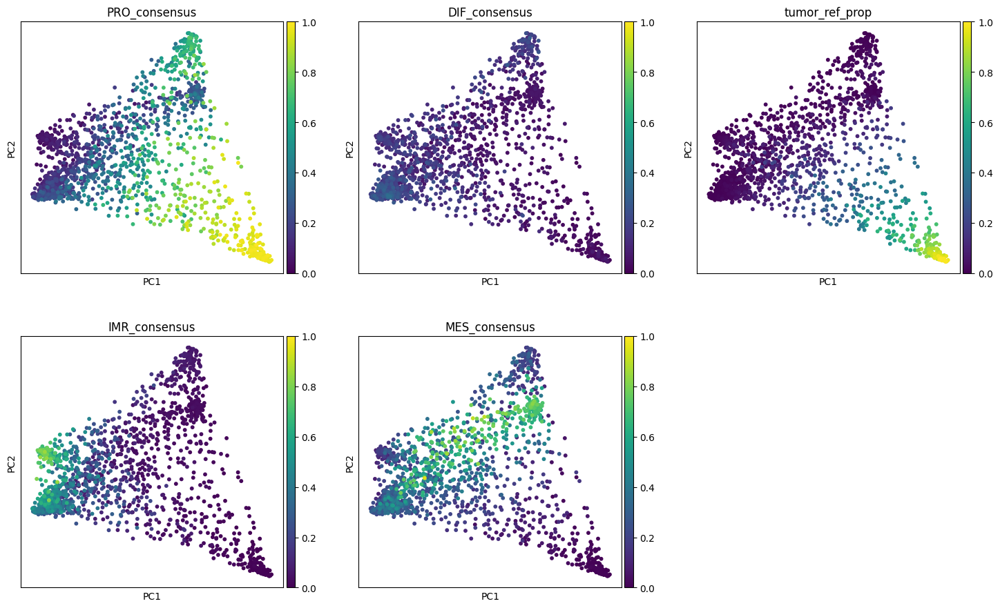

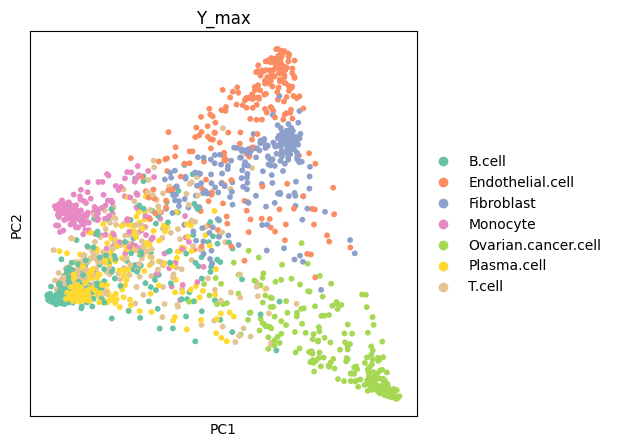

In [10]:
# Proliferative
samp_id = "SPECTRUM-OV-083_S1_INFRACOLIC_OMENTUM"
fig, axs = plt.subplots(4, 3, figsize=(10, 10))
axs = plot_scores_props(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

fig, axs = plt.subplots(1, 2, figsize=(6, 3))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)



/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

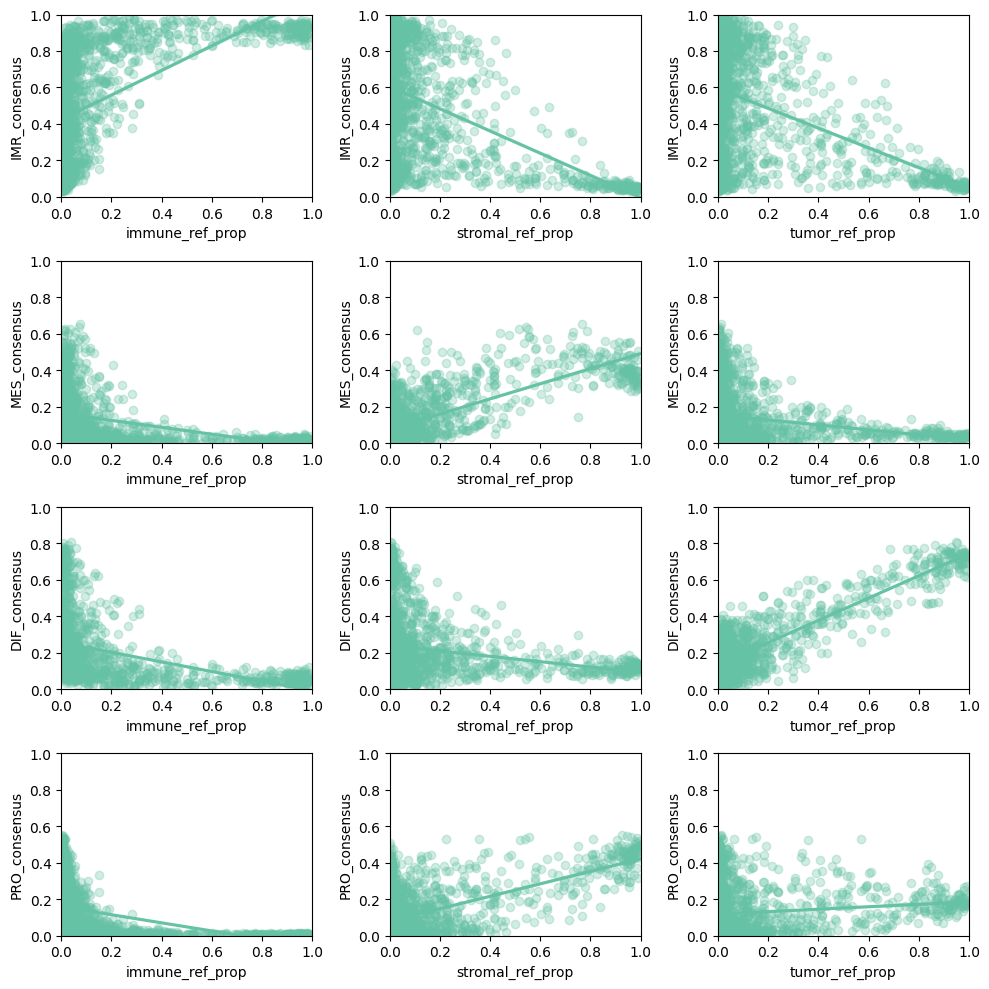

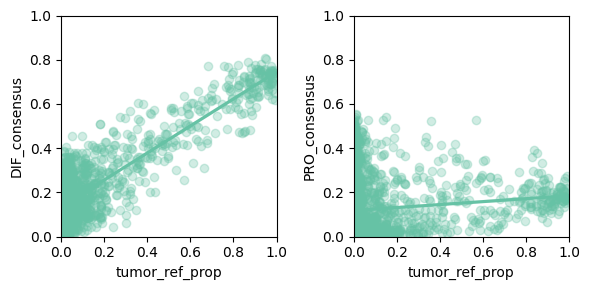

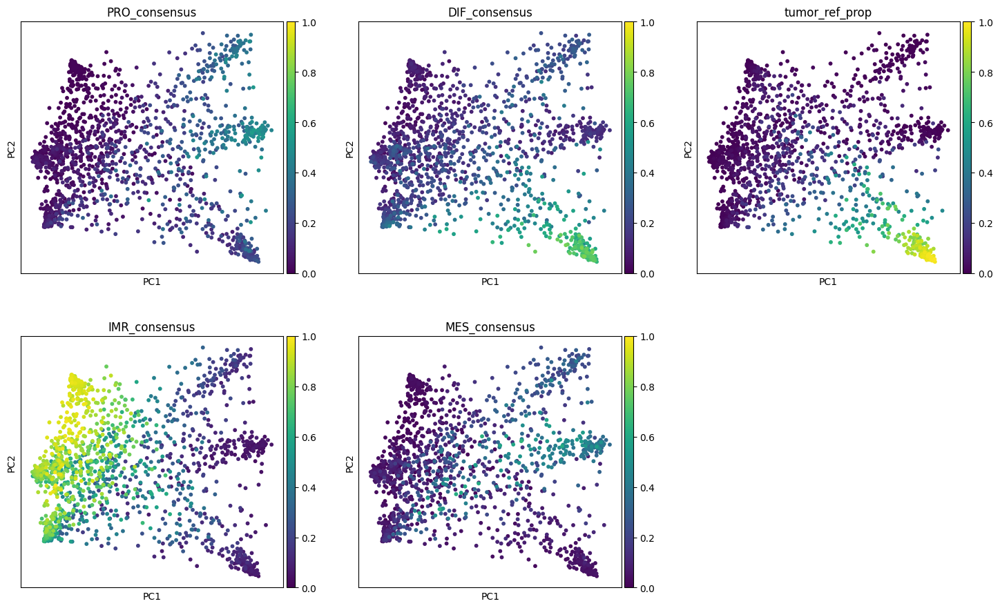

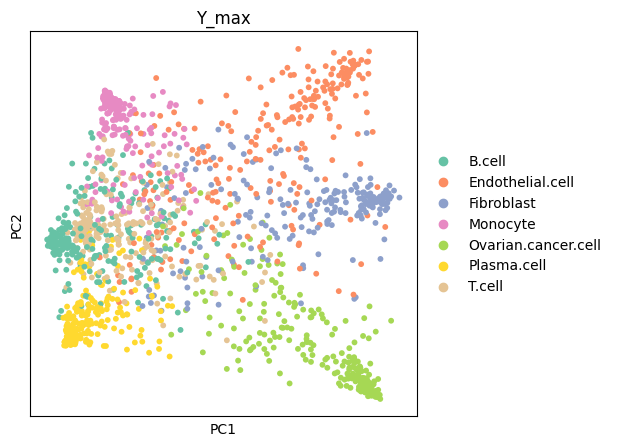

In [11]:
# Diferentiated

samp_id = "SPECTRUM-OV-036_S1_INFRACOLIC_OMENTUM"
fig, axs = plt.subplots(4, 3, figsize=(10, 10))
axs = plot_scores_props(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

fig, axs = plt.subplots(1, 2, figsize=(6, 3))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)



/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

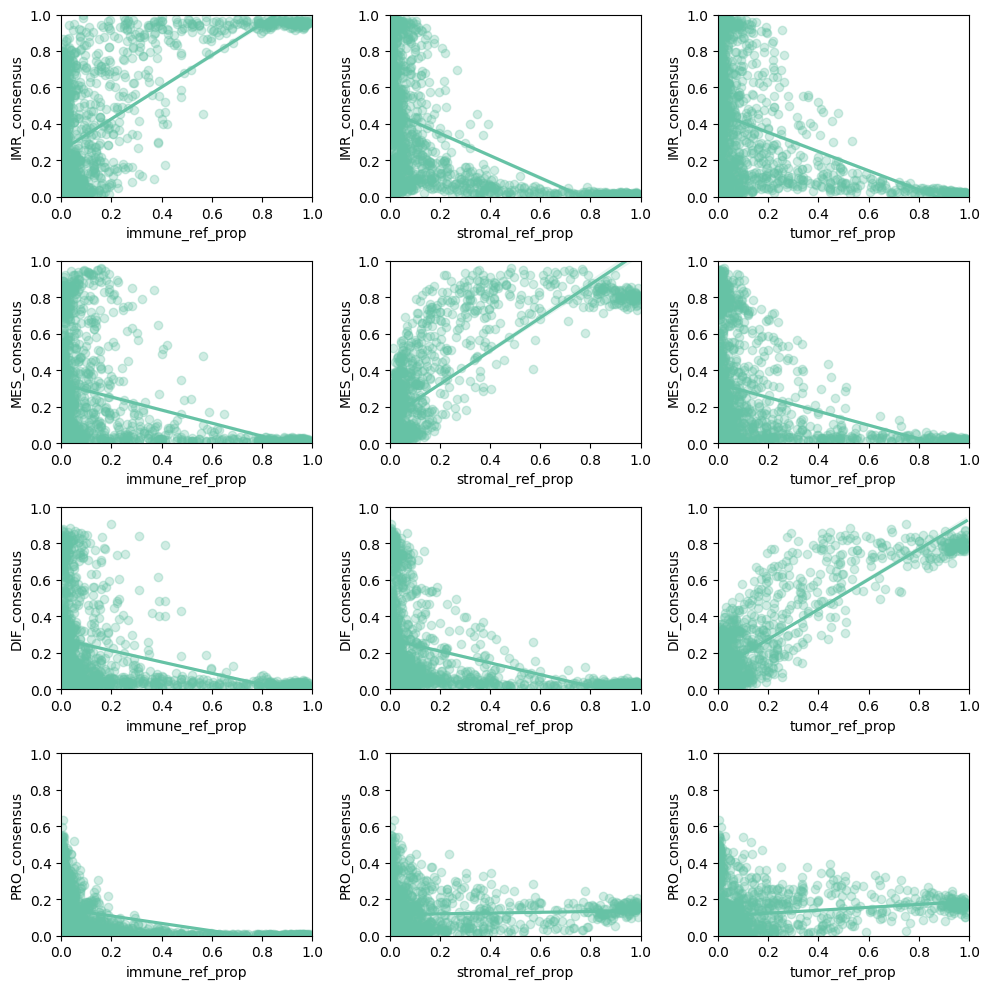

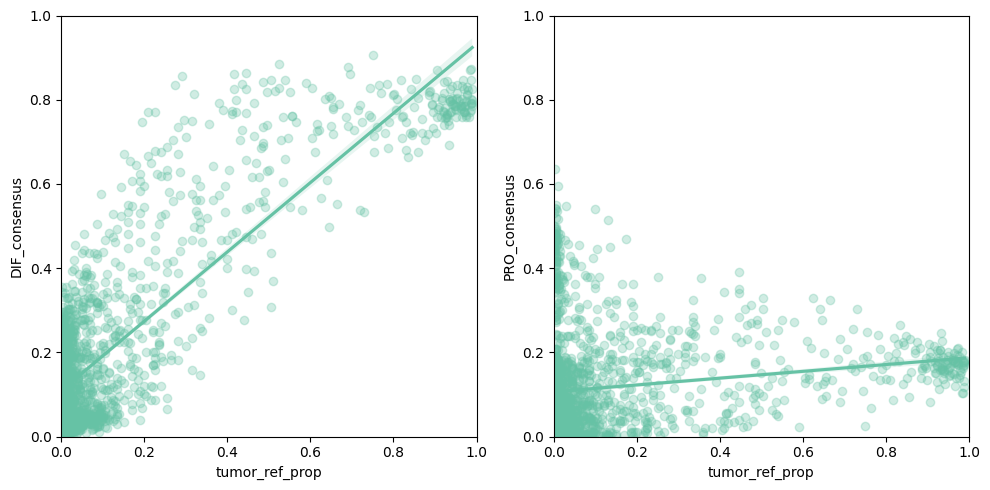

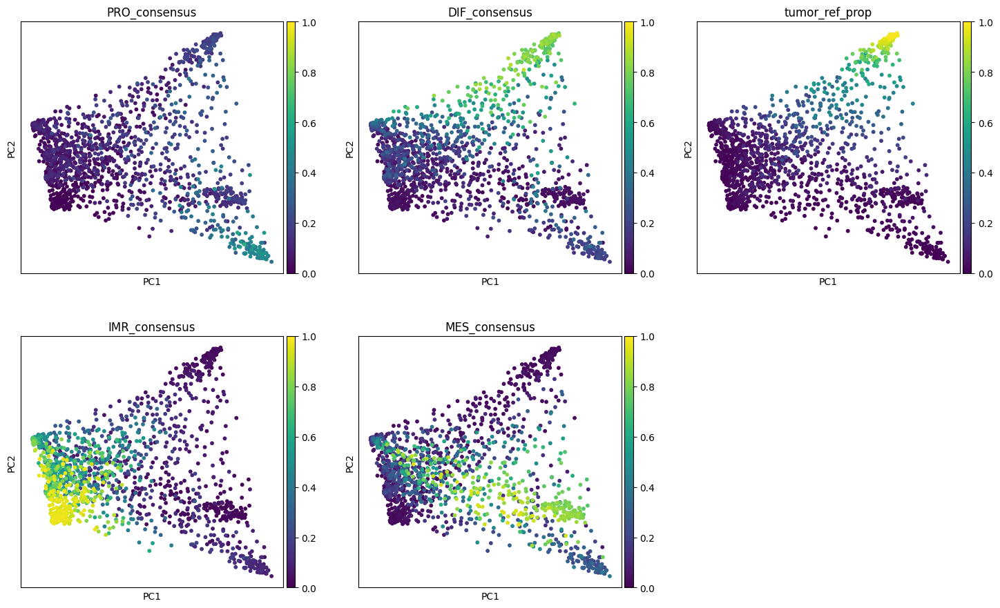

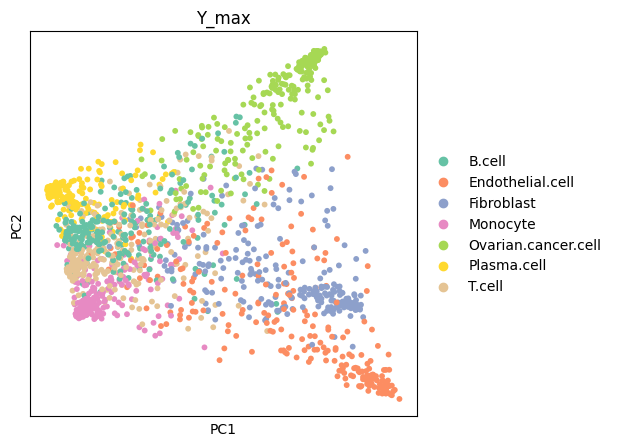

In [12]:
# differentiated

samp_id = "SPECTRUM-OV-024_S1_INFRACOLIC_OMENTUM"
fig, axs = plt.subplots(4, 3, figsize=(10, 10))
axs = plot_scores_props(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

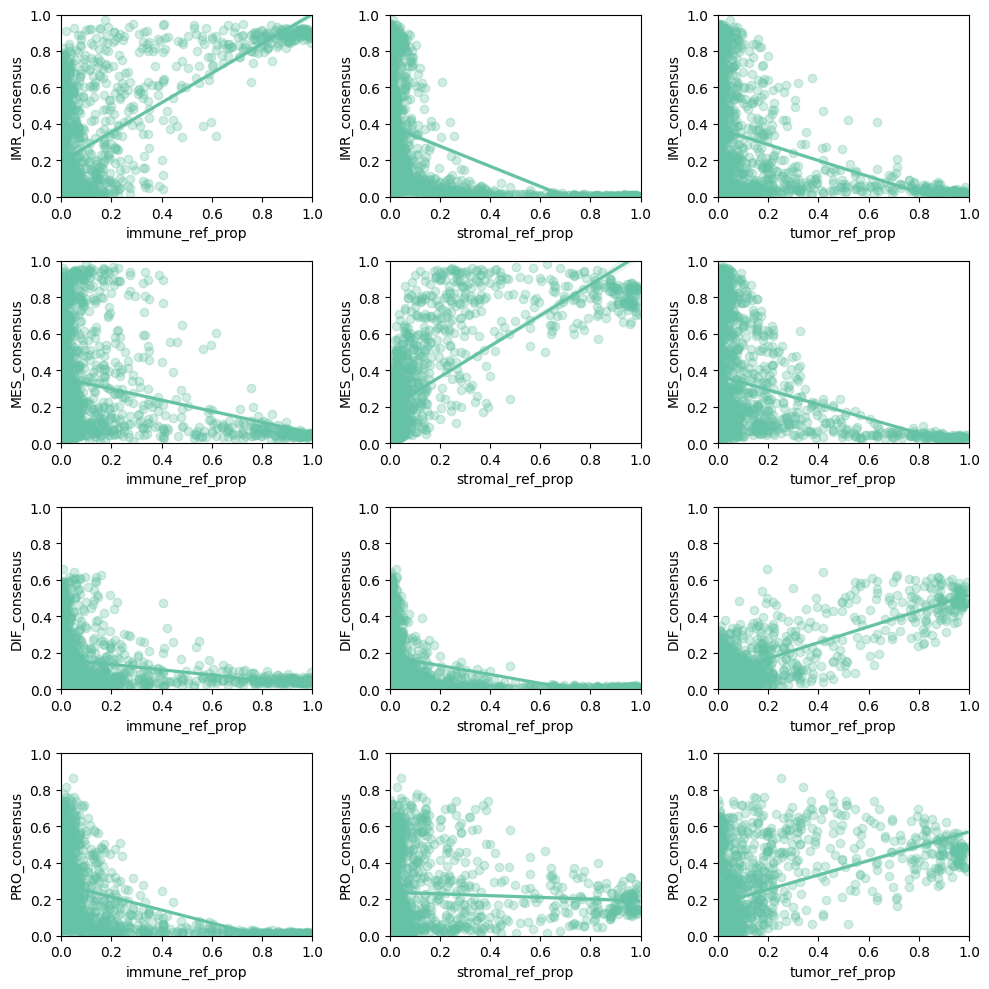

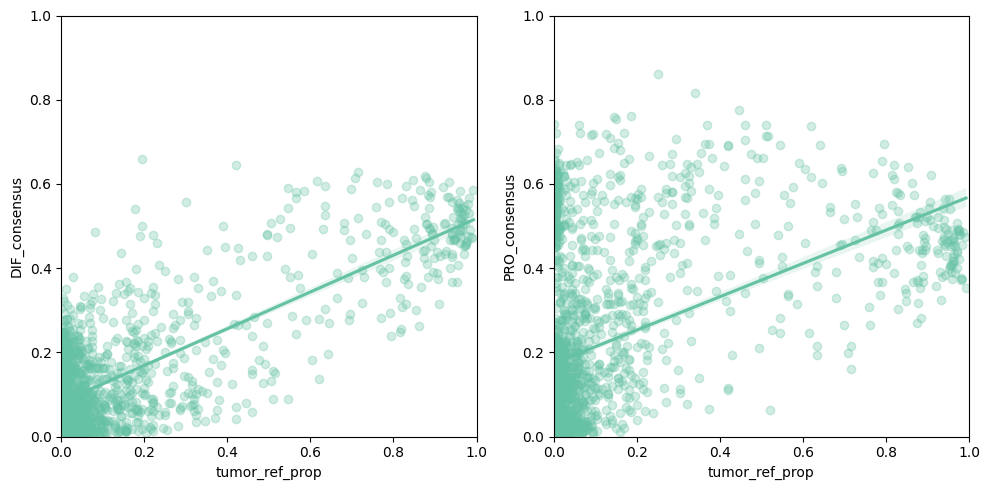

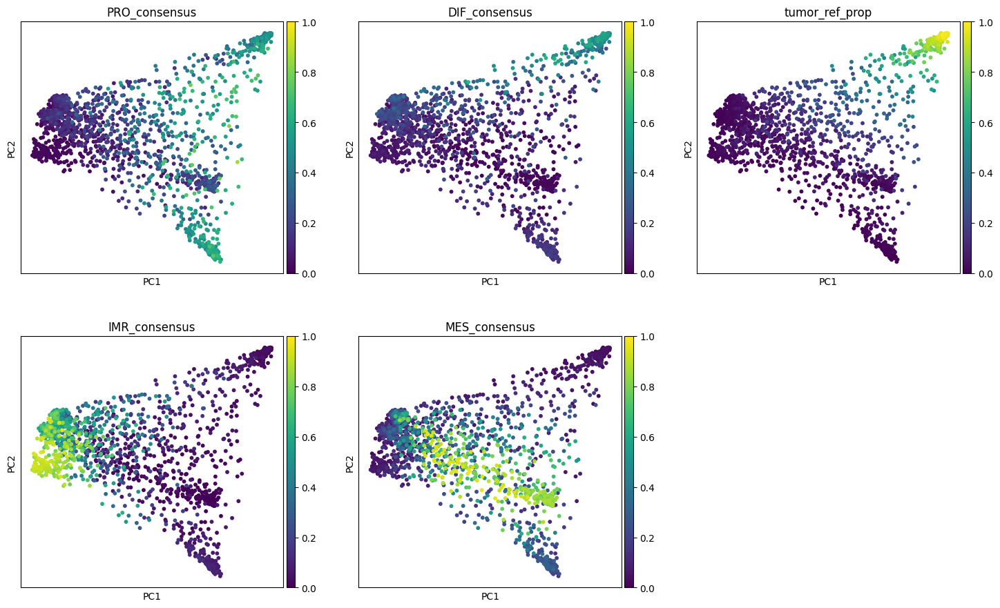

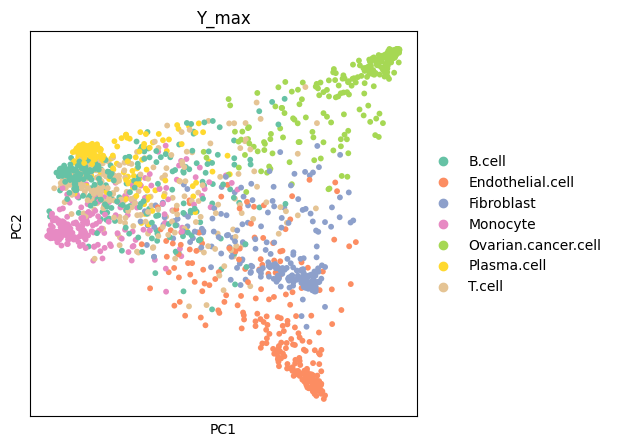

In [13]:
# Mid
samp_id = "SPECTRUM-OV-110_S1_INFRACOLIC_OMENTUM"
fig, axs = plt.subplots(4, 3, figsize=(10, 10))
axs = plot_scores_props(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)




# GSE154600

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

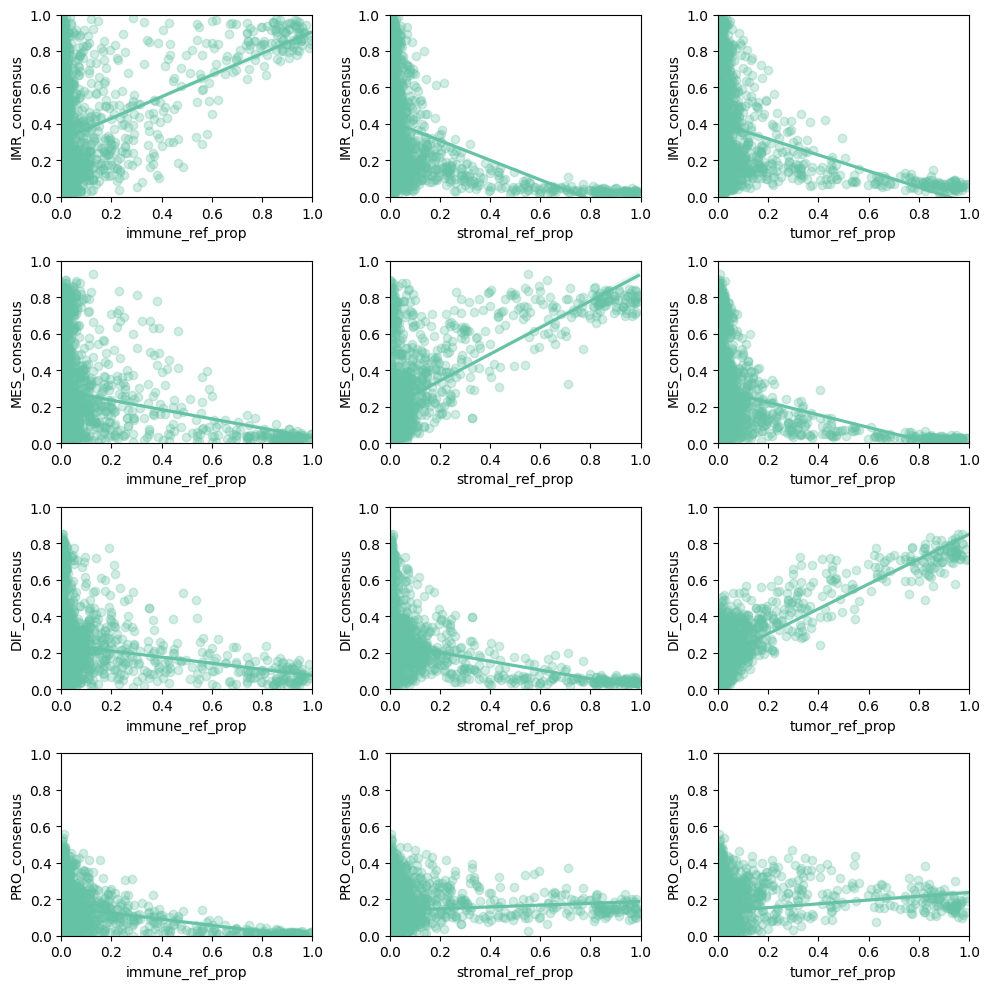

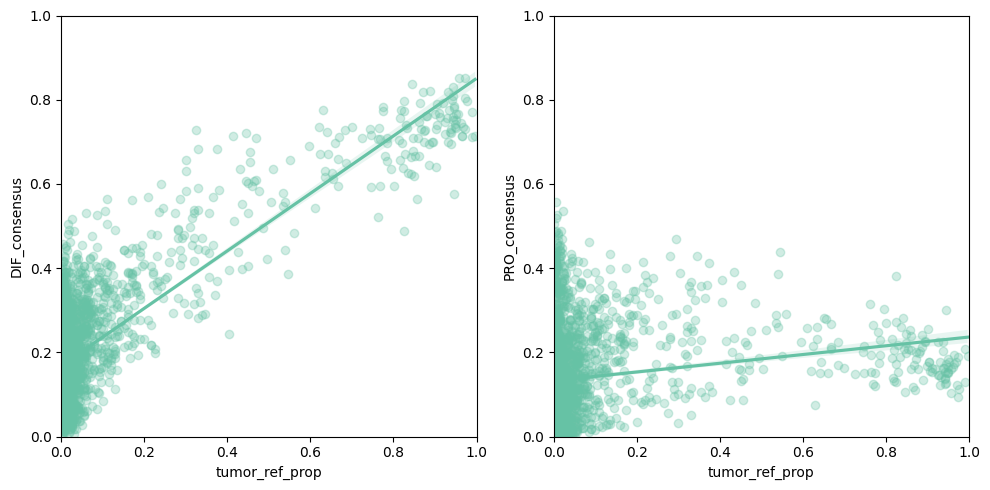

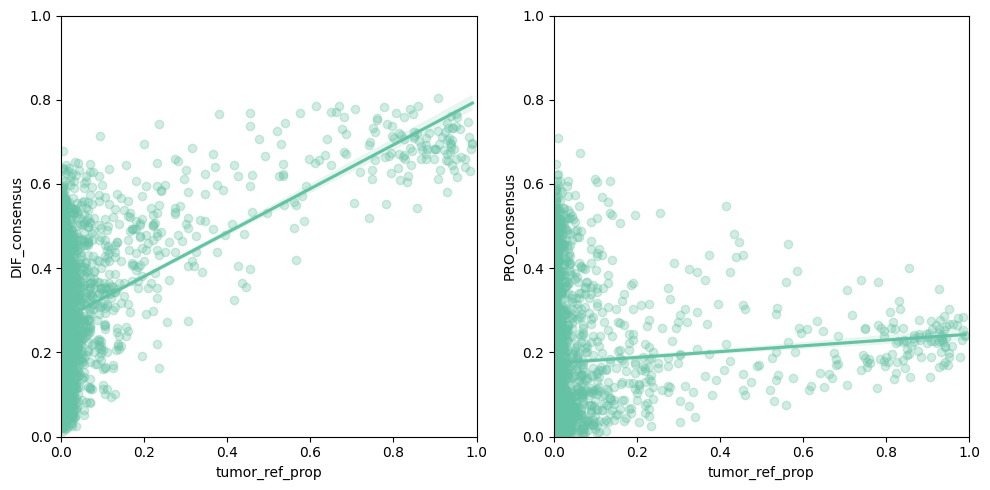

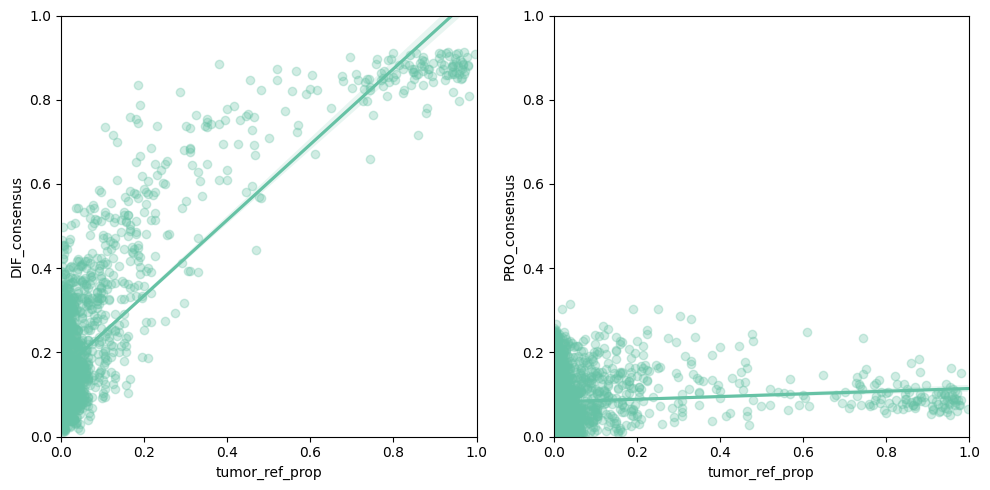

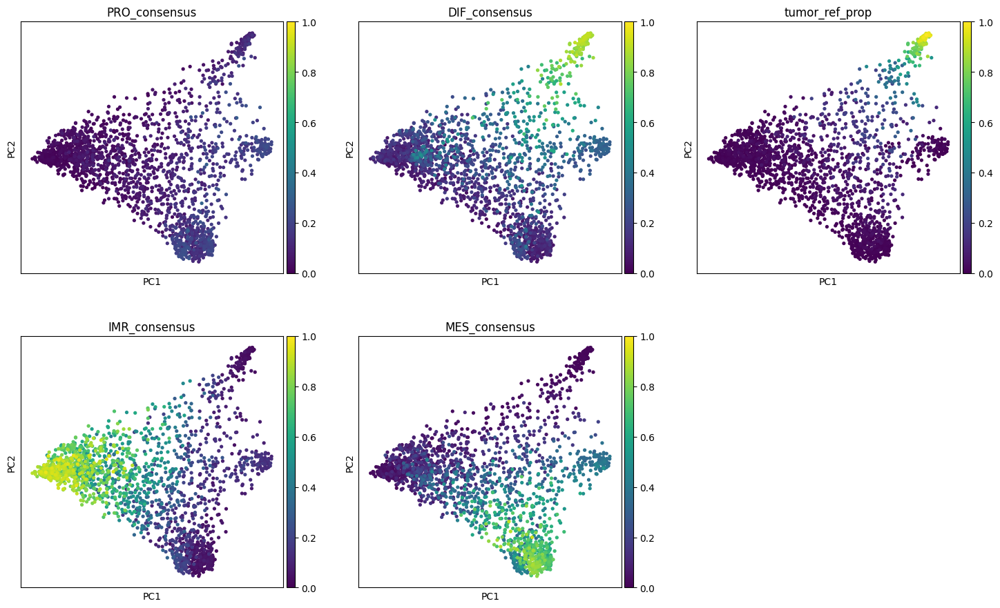

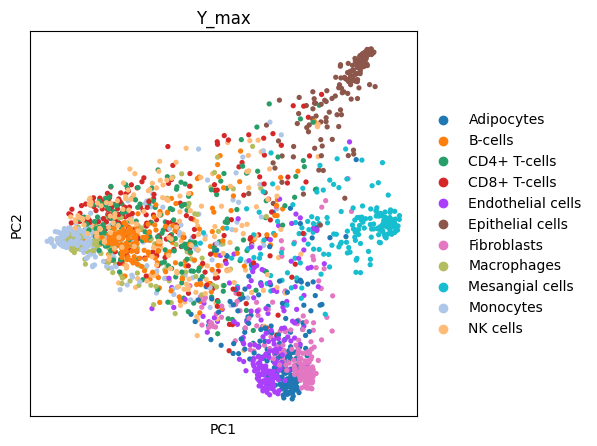

In [14]:
# Diff

samp_id = "Samp_T59"
fig, axs = plt.subplots(4, 3, figsize=(10, 10))
axs = plot_scores_props(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_T77"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_T89"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)



In [15]:
mid_adata.obs

,sample_id,stim,isTraining,cell_prop_type,samp_type,IMR_consensus,DIF_consensus,PRO_consensus,MES_consensus,subtype,Y_max,GSE_ID,tumor_ref_prop,immune_ref_prop,stromal_ref_prop,prop_max
6300,Samp_T89,CTRL,Train,random,sc_ref,0.190,0.164,0.140,0.506,MES,CD4+ T-cells,GSE154600,0.045000,0.035000,0.200000,mid
6301,Samp_T89,CTRL,Train,random,sc_ref,0.362,0.326,0.092,0.220,IMR,NK cells,GSE154600,0.150000,0.015000,0.030000,mid
6302,Samp_T89,CTRL,Train,random,sc_ref,0.068,0.134,0.204,0.594,MES,Fibroblasts,GSE154600,0.025000,0.005000,0.335000,mid
6303,Samp_T89,CTRL,Train,random,sc_ref,0.162,0.472,0.134,0.232,DIF,B-cells,GSE154600,0.130000,0.035000,0.010000,mid
6304,Samp_T89,CTRL,Train,random,sc_ref,0.278,0.242,0.078,0.402,MES,Monocytes,GSE154600,0.035000,0.300000,0.220000,mid
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8395,Samp_T89,CTRL,Train,cell_type_specific,sc_ref,0.822,0.094,0.008,0.076,IMR,NK cells,GSE154600,0.001841,0.019249,0.005447,mid
8396,Samp_T89,CTRL,Train,cell_type_specific,sc_ref,0.512,0.226,0.084,0.178,IMR,NK cells,GSE154600,0.002711,0.001616,0.000400,mid
8397,Samp_T89,CTRL,Train,cell_type_specific,sc_ref,0.568,0.356,0.028,0.048,IMR,NK cells,GSE154600,0.013602,0.003434,0.003487,mid
8398,Samp_T89,CTRL,Train,cell_type_specific,sc_ref,0.282,0.078,0.076,0.564,MES,NK cells,GSE154600,0.004327,0.004830,0.075071,mid


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

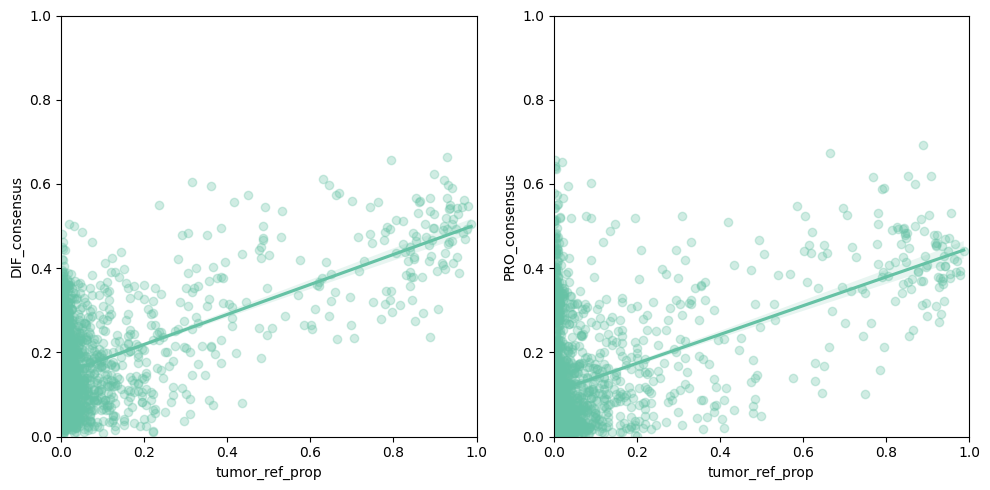

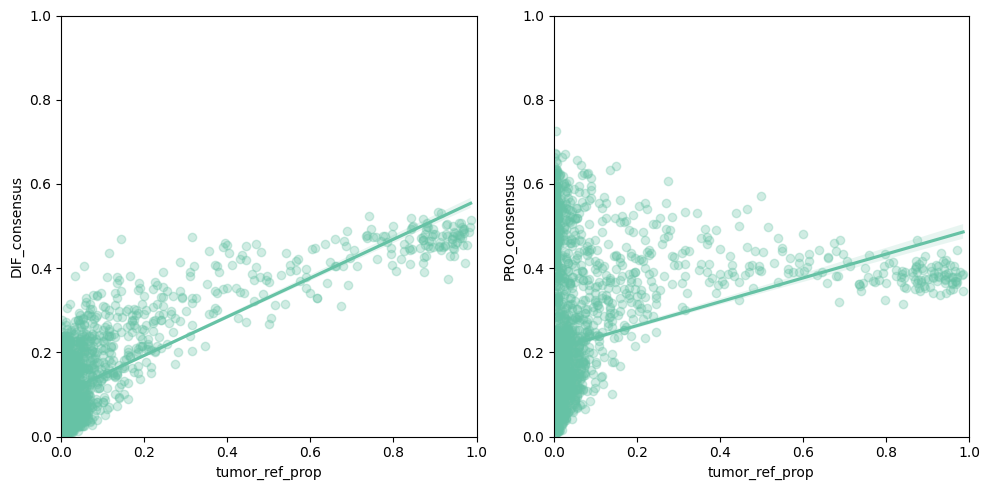

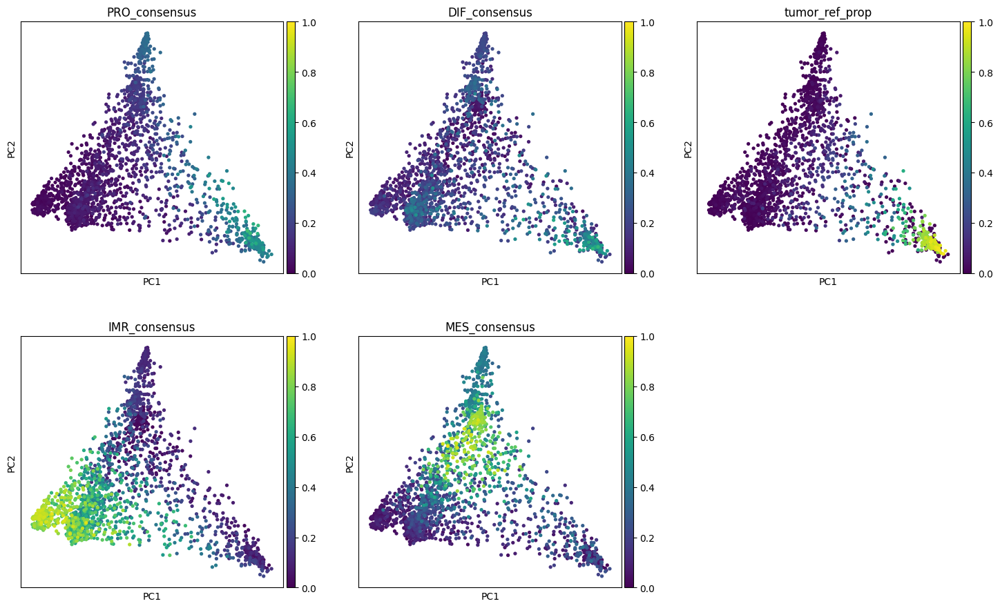

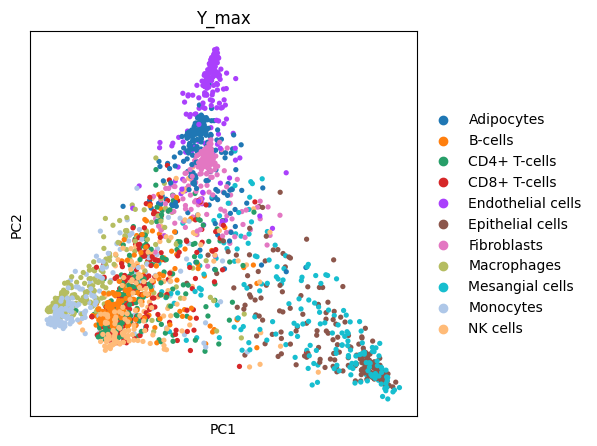

In [16]:
# Mid

samp_id = "Samp_T90"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_T76"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == "Samp_T90")[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)


# GSE165897

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

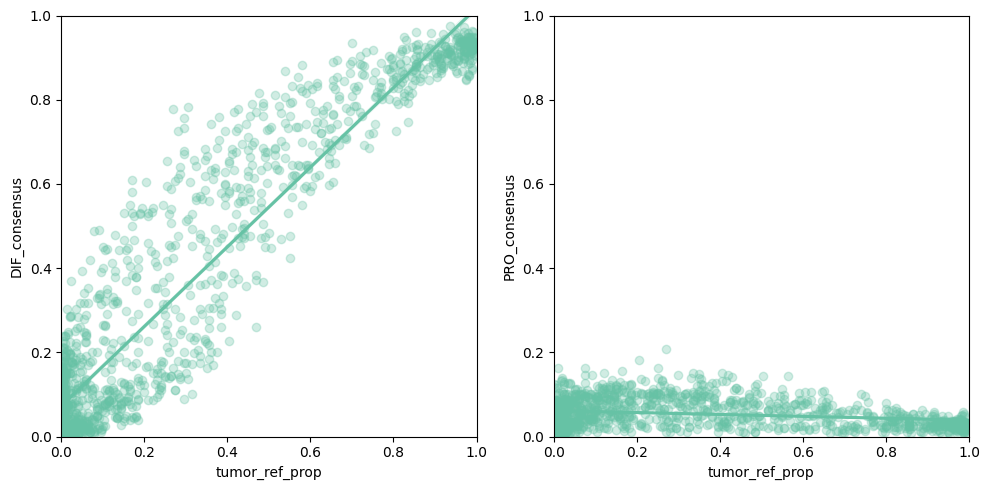

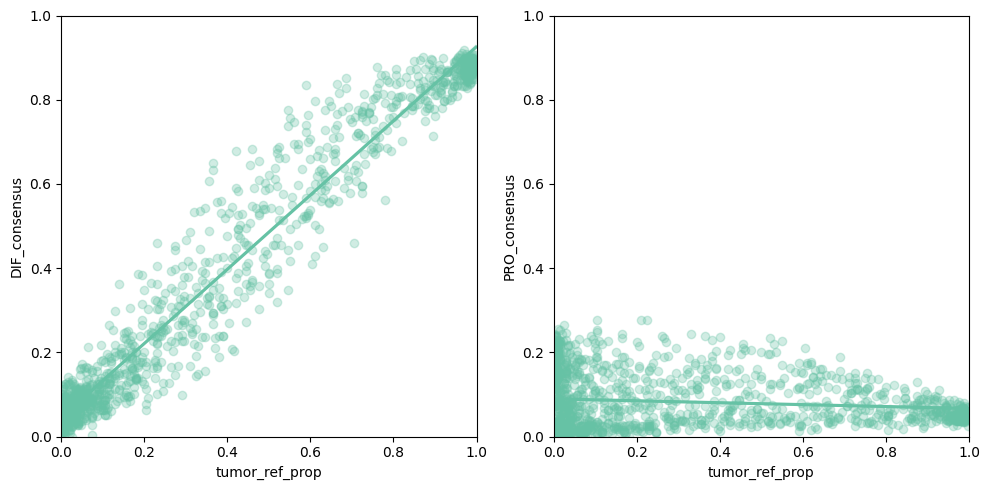

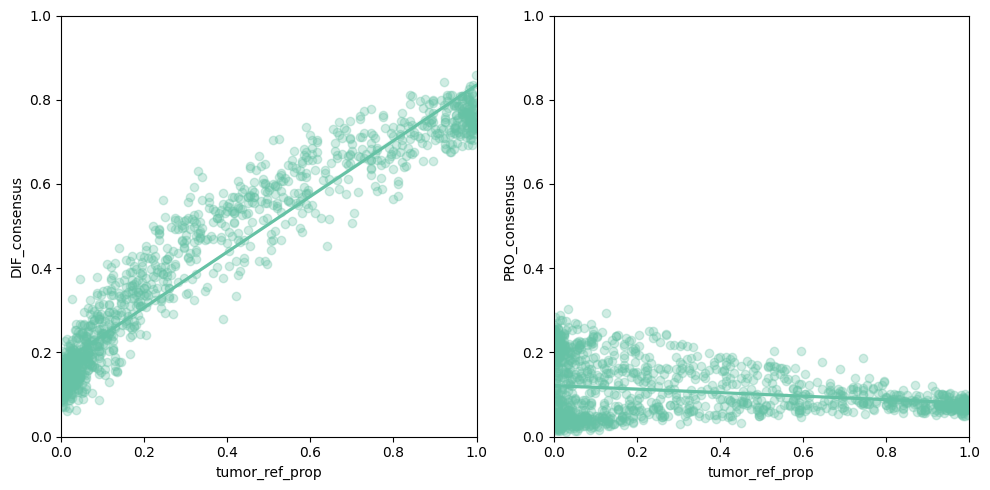

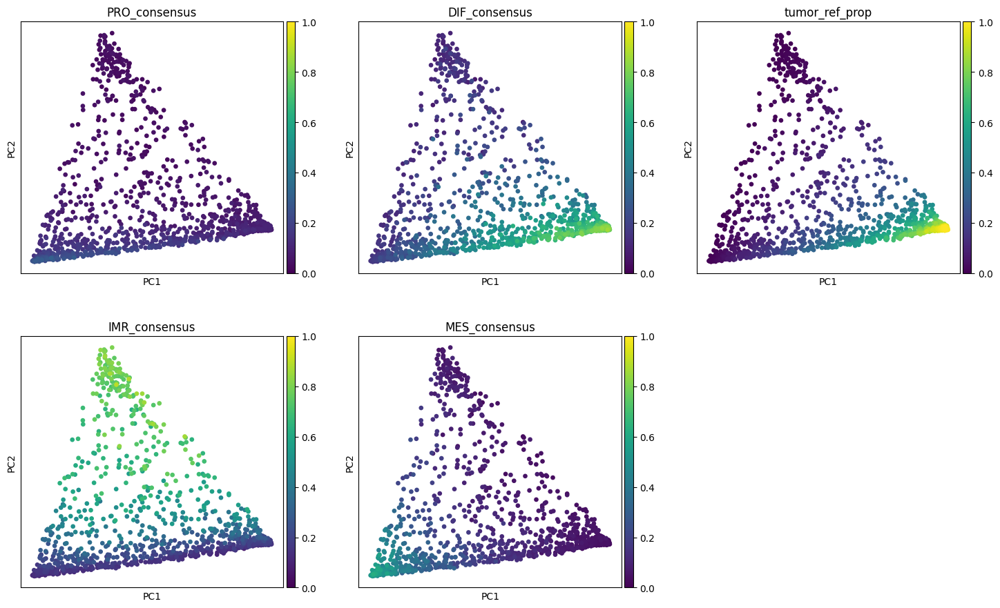

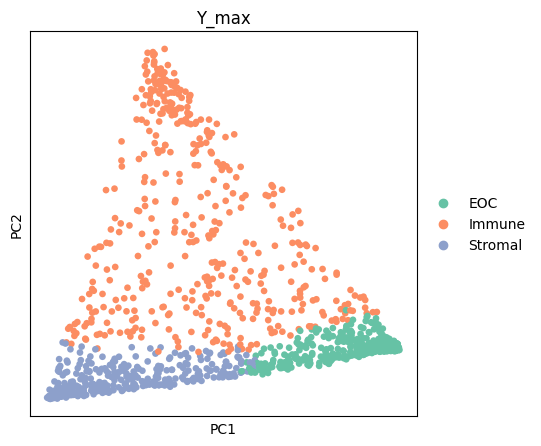

In [17]:
# Diff

samp_id = "Samp_EOC3_interval_Omentum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_EOC3_primary_Peritoneum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


samp_id = "Samp_EOC227_primary_Omentum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

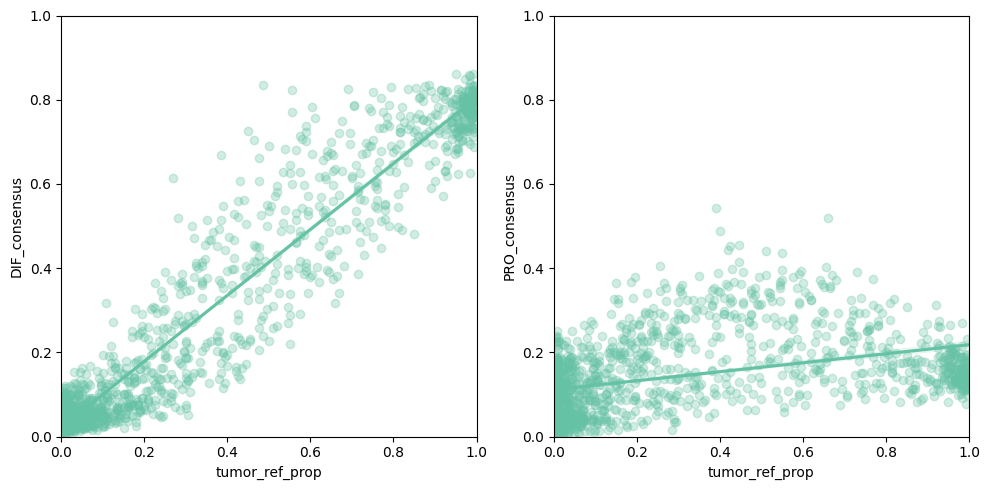

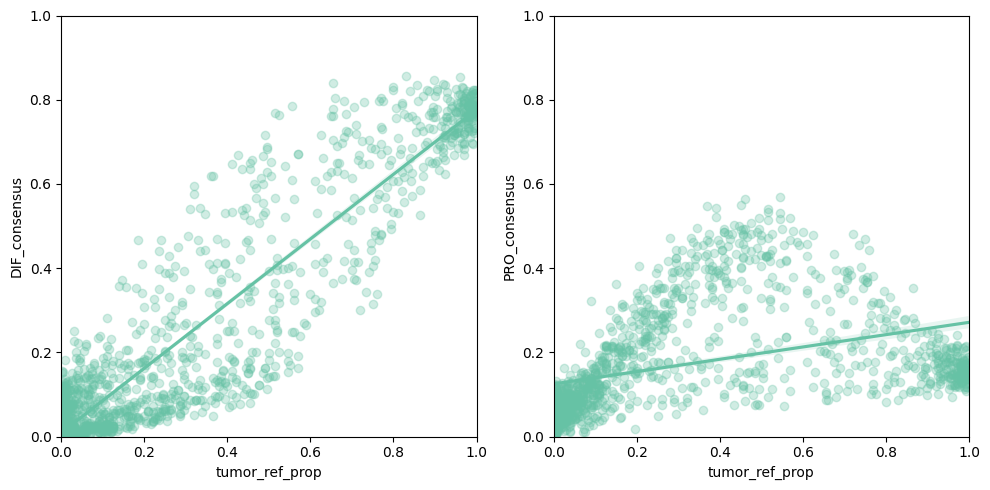

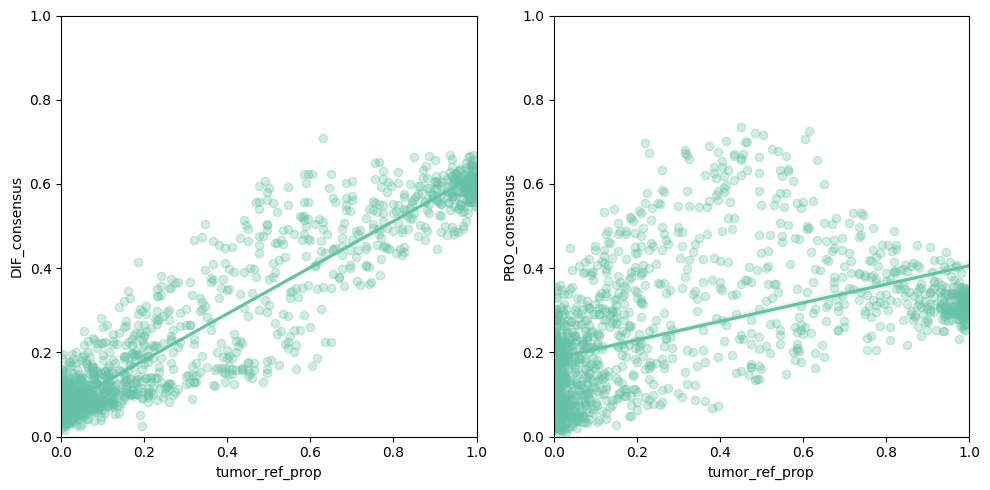

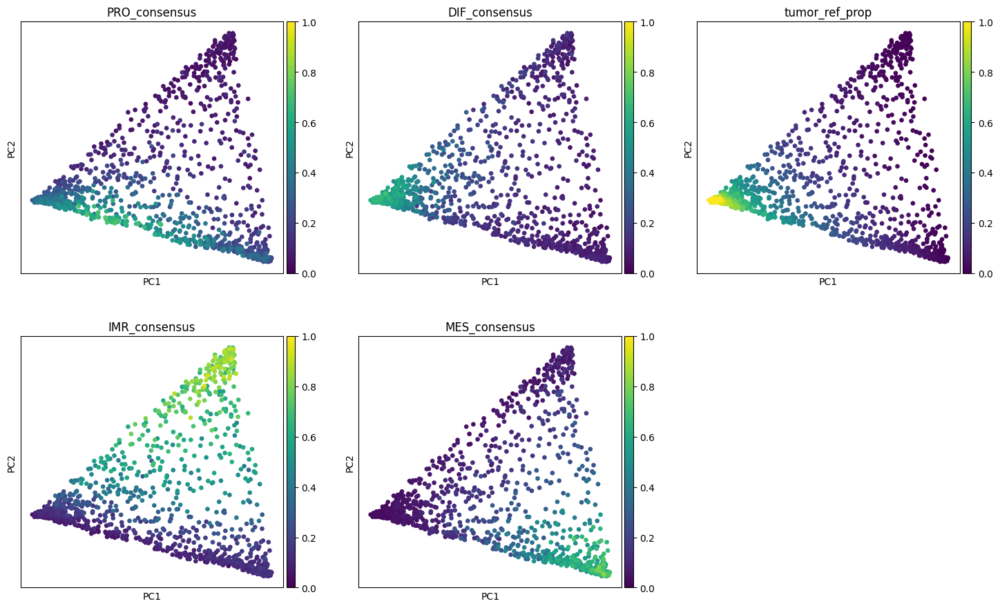

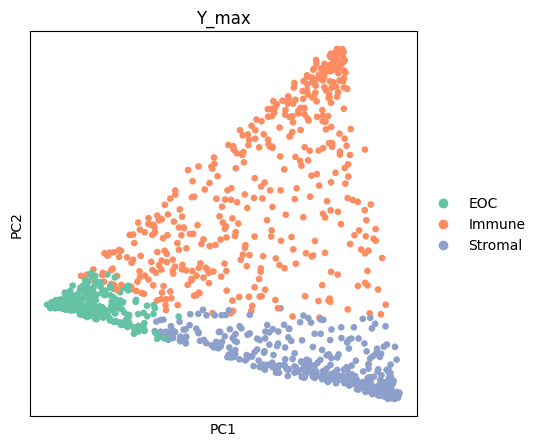

In [18]:
# Mid

samp_id = "Samp_EOC87_primary_Peritoneum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_EOC87_interval_Omentum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_EOC1005_primary_Peritoneum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)




/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

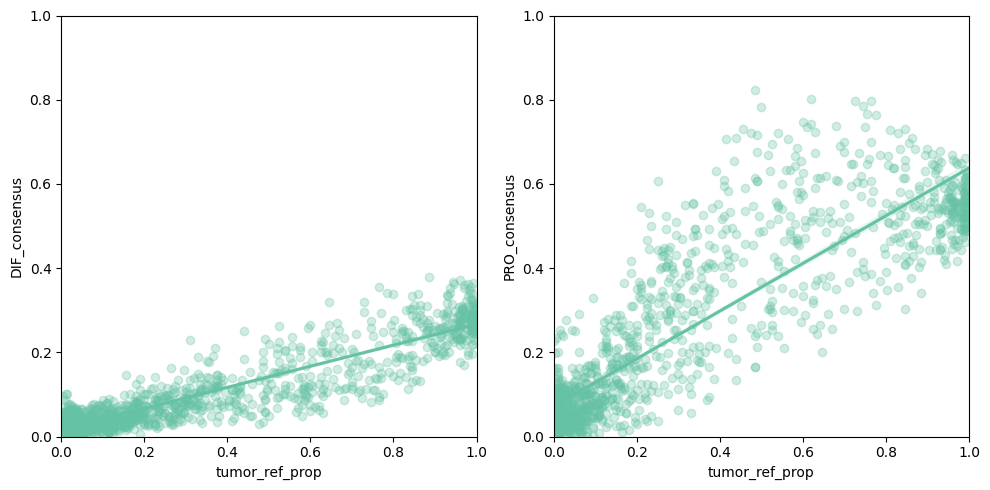

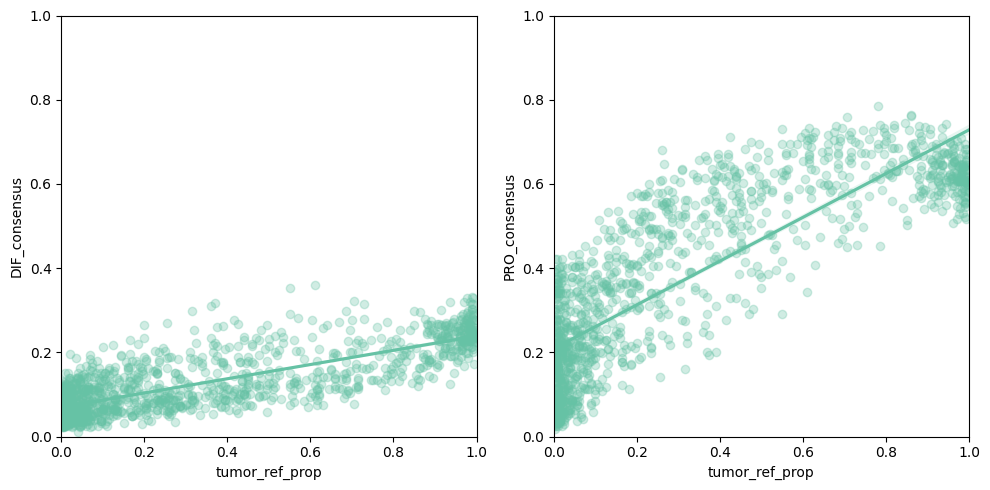

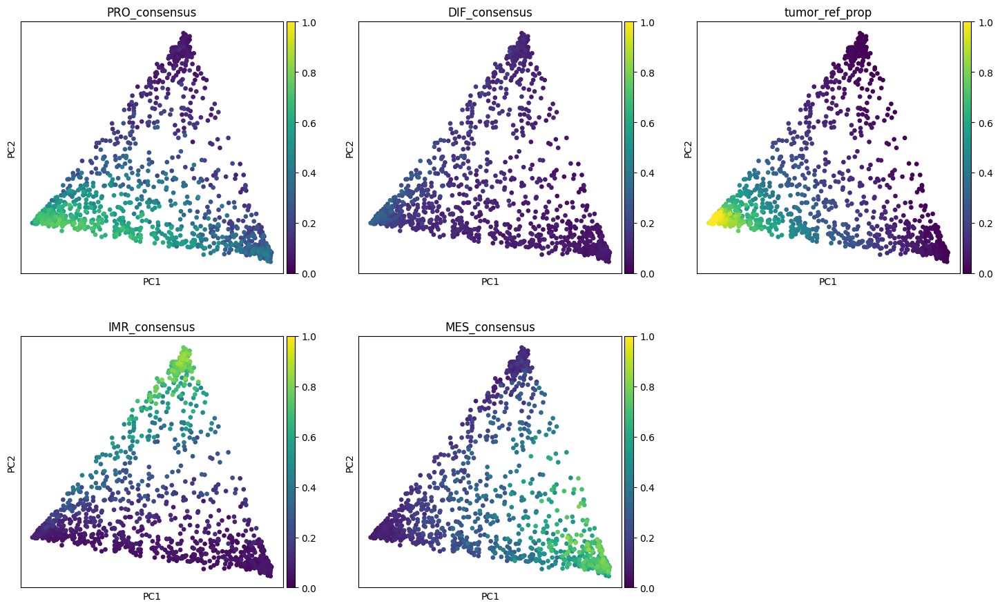

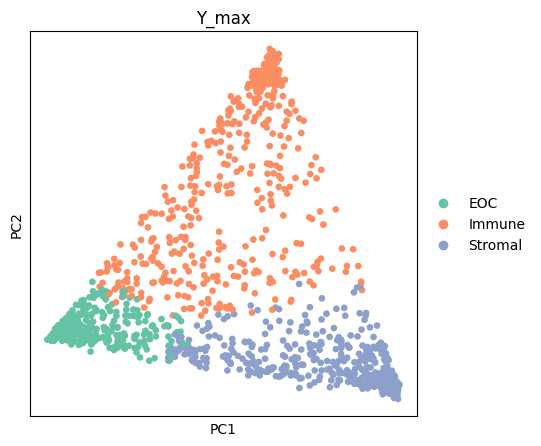

In [19]:
# Pro

samp_id = "Samp_EOC153_primary_Omentum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_EOC372_primary_Peritoneum"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()



idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)


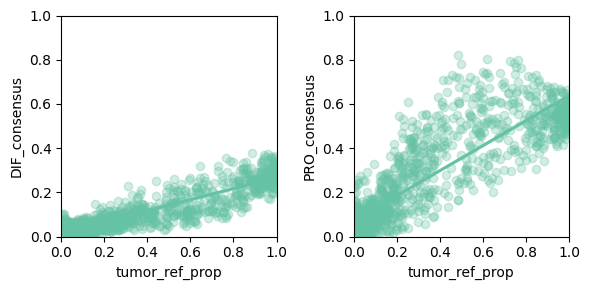

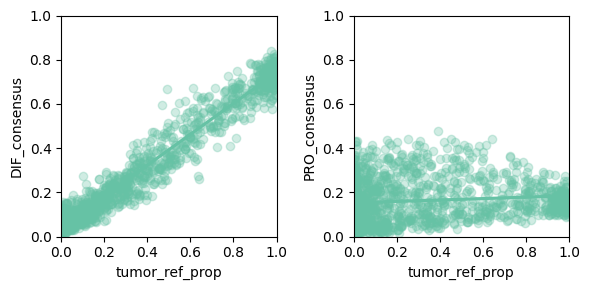

In [20]:
# pro to diff switch


samp_id = "Samp_EOC153_primary_Omentum"
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
plt.tight_layout()

samp_id = "Samp_EOC153_interval_Omentum"
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)

plt.tight_layout()
plt.show()

# GSE192898

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

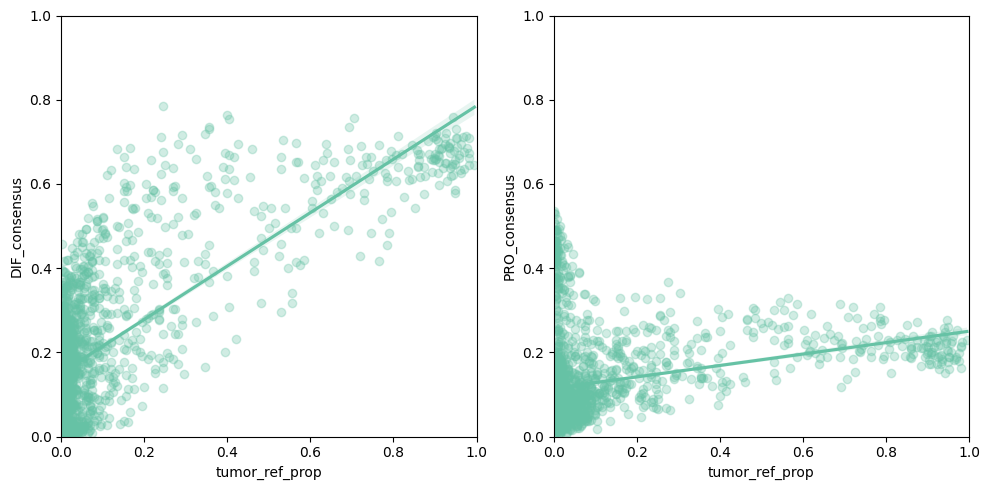

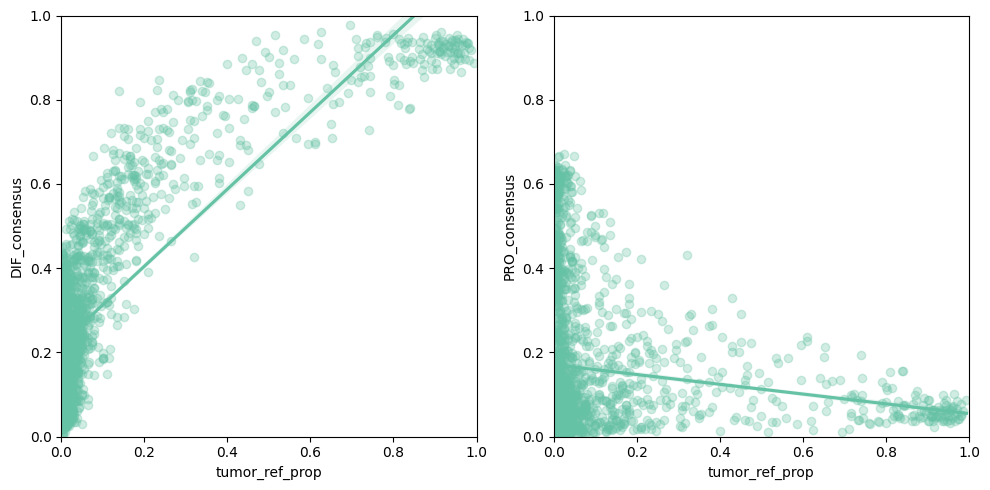

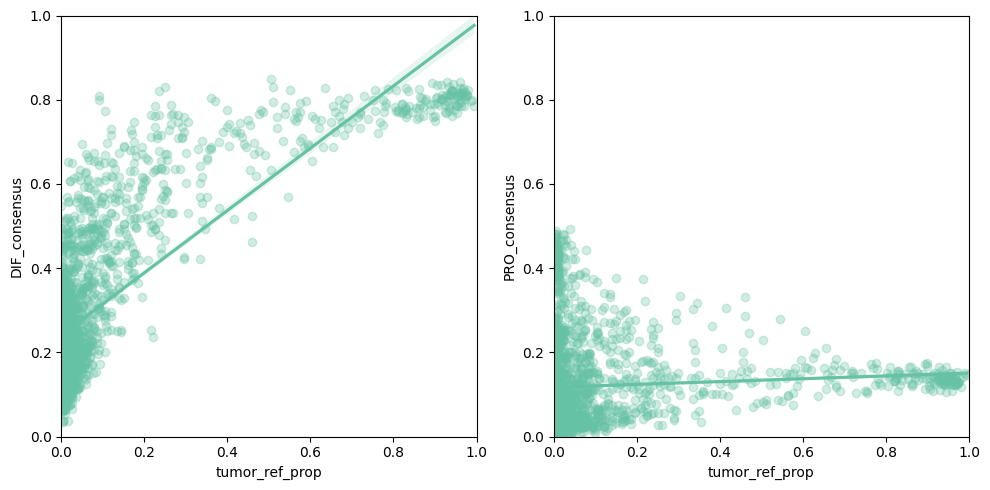

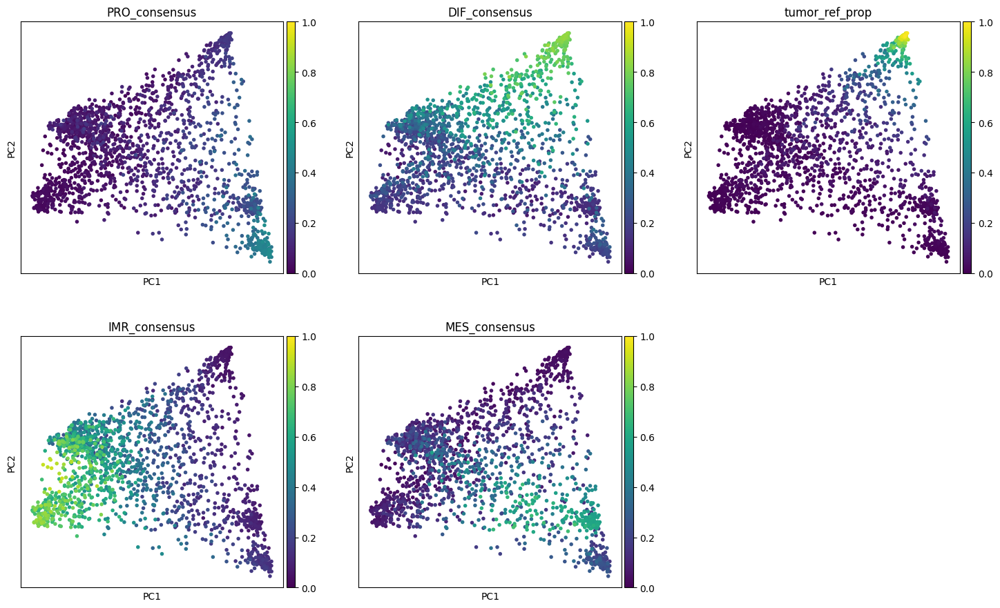

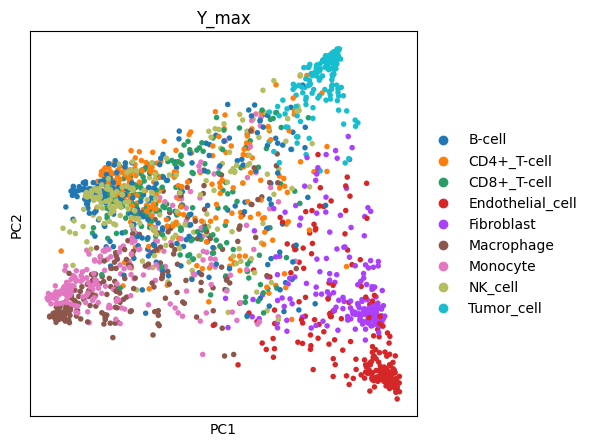

In [21]:
# Diff

samp_id = "ovCHA004"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "ovCHA018"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


samp_id = "ovCHA039"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)




/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

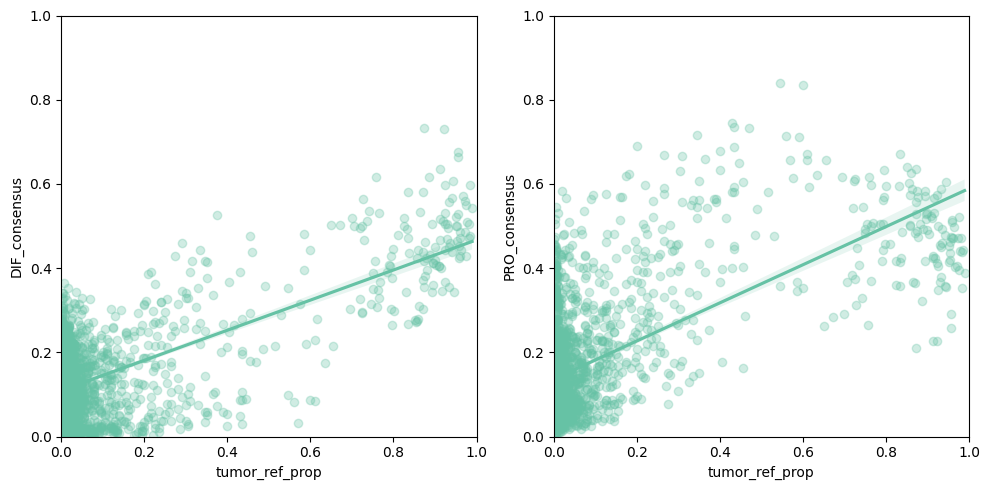

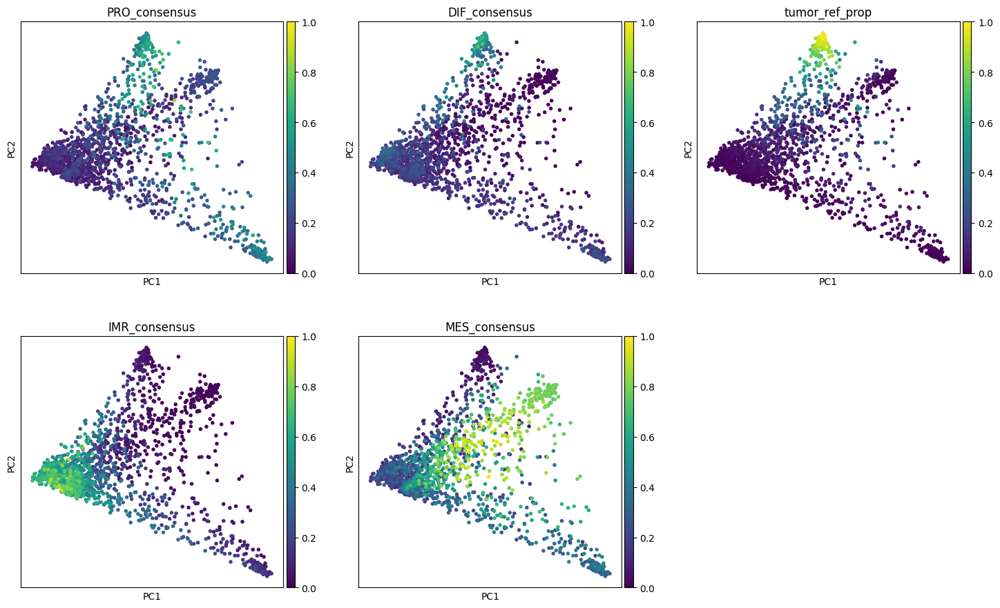

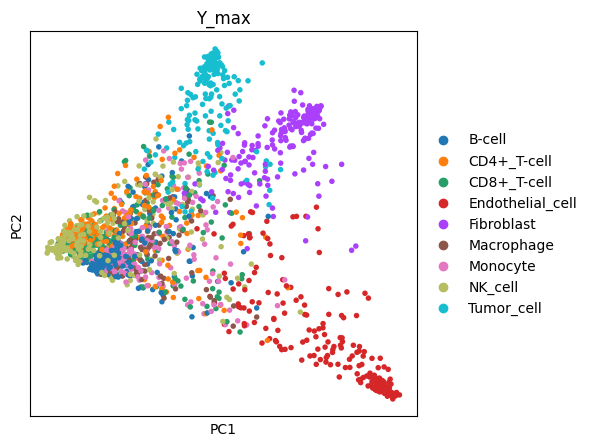

subtype,DIF,IMR,MES,PRO
subtype_total,,,,
DIF,80,843,709,149
PRO,0,0,0,119


In [22]:
# Mid

samp_id = "ovCHA034"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)


# get the proliferative where the 
cell_type_vec = np.array(mid_adata.obs.subtype)
cell_type_vec[np.where(mid_adata.obs.subtype.isin(["PRO", "IMR", "MES"]))] = "DIF"

idx = np.logical_and(mid_adata.obs.subtype == "PRO", mid_adata.obs.Y_max.isin(tumor_cell_ids))
pro_label_idx = np.where(idx)[0]
cell_type_vec[pro_label_idx] = "PRO"

mid_adata.obs['subtype_total'] = cell_type_vec

tab = mid_adata.obs.groupby(['subtype_total', 'subtype']).size()
tab.unstack()


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

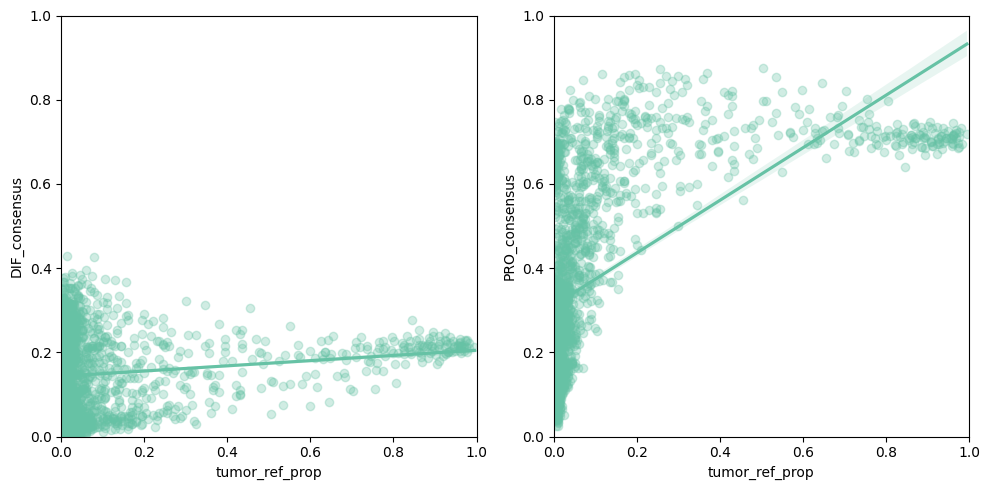

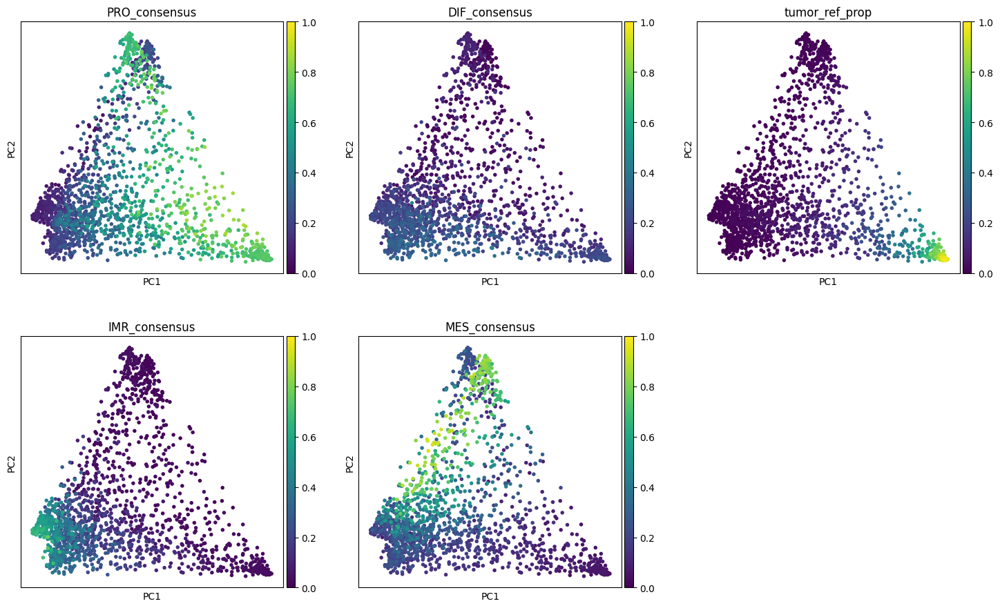

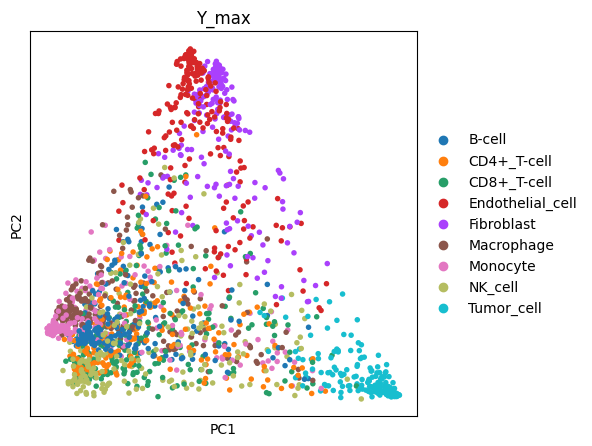

In [23]:
# Pro

samp_id = "ovCHA070"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)



# GSE217517

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

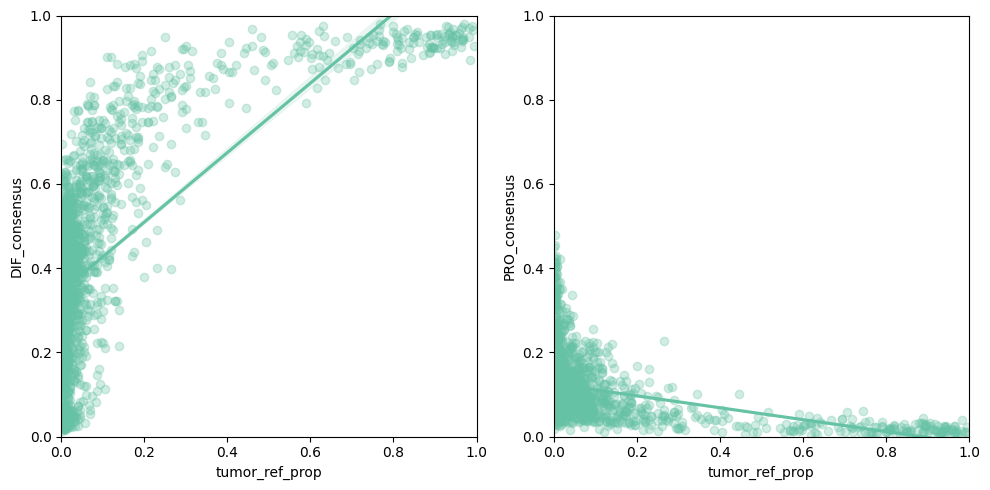

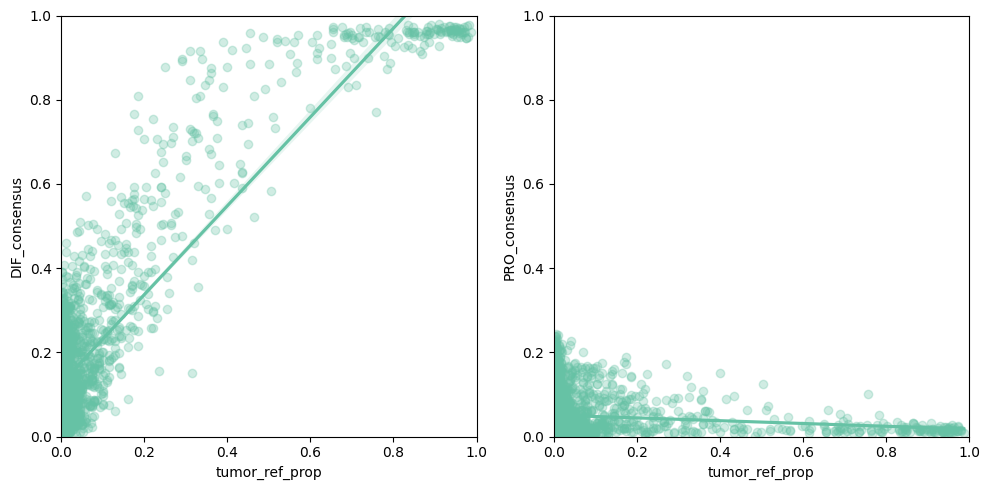

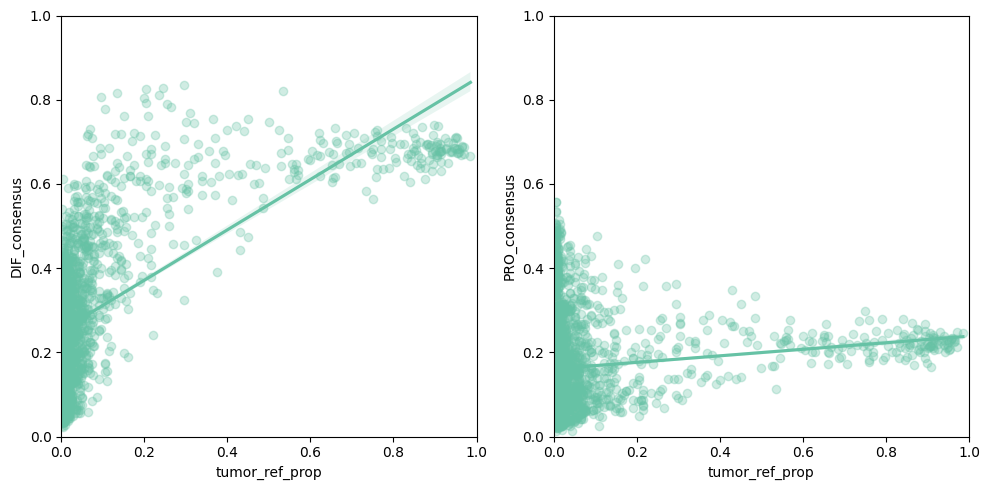

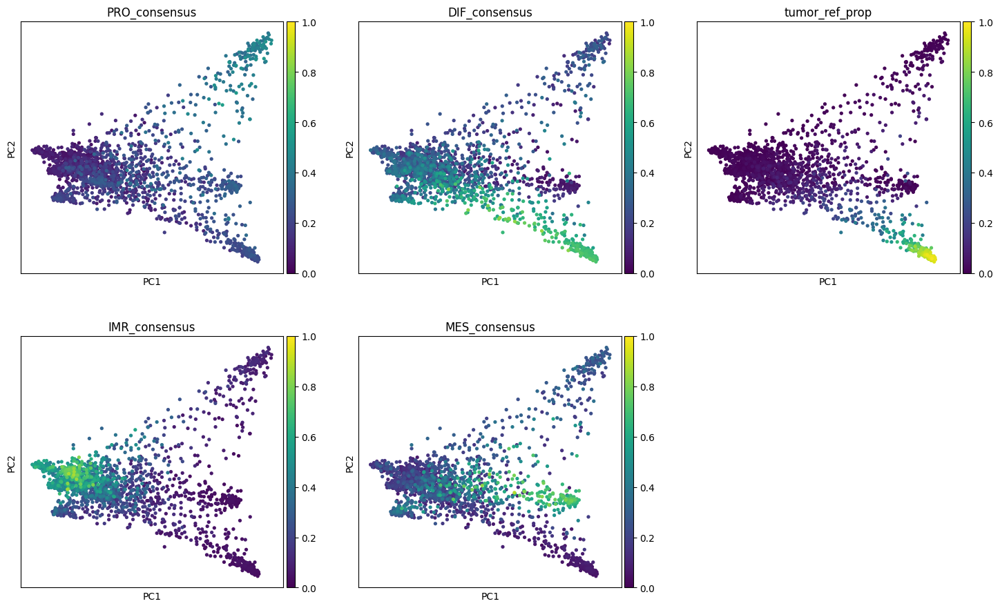

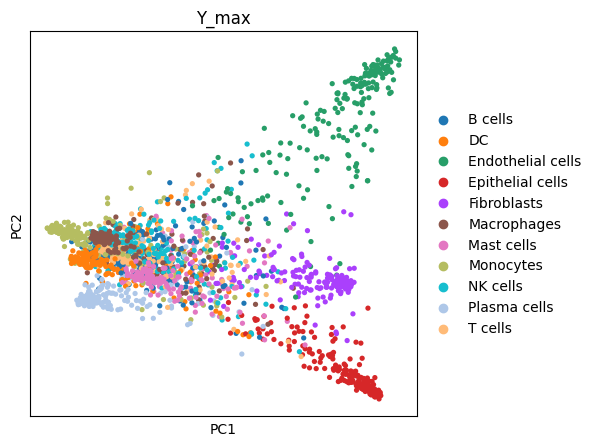

subtype,DIF,IMR,MES,PRO
subtype_total,,,,
DIF,678,785,459,178


In [24]:
# Diff

samp_id = "Samp_2251"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()

samp_id = "Samp_2293"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


samp_id = "Samp_2380"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)



# get the proliferative where the 
cell_type_vec = np.array(mid_adata.obs.subtype)
cell_type_vec[np.where(mid_adata.obs.subtype.isin(["PRO", "IMR", "MES"]))] = "DIF"

idx = np.logical_and(mid_adata.obs.subtype == "PRO", mid_adata.obs.Y_max.isin(tumor_cell_ids))
pro_label_idx = np.where(idx)[0]
cell_type_vec[pro_label_idx] = "PRO"

mid_adata.obs['subtype_total'] = cell_type_vec

tab = mid_adata.obs.groupby(['subtype_total', 'subtype']).size()
tab.unstack()


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

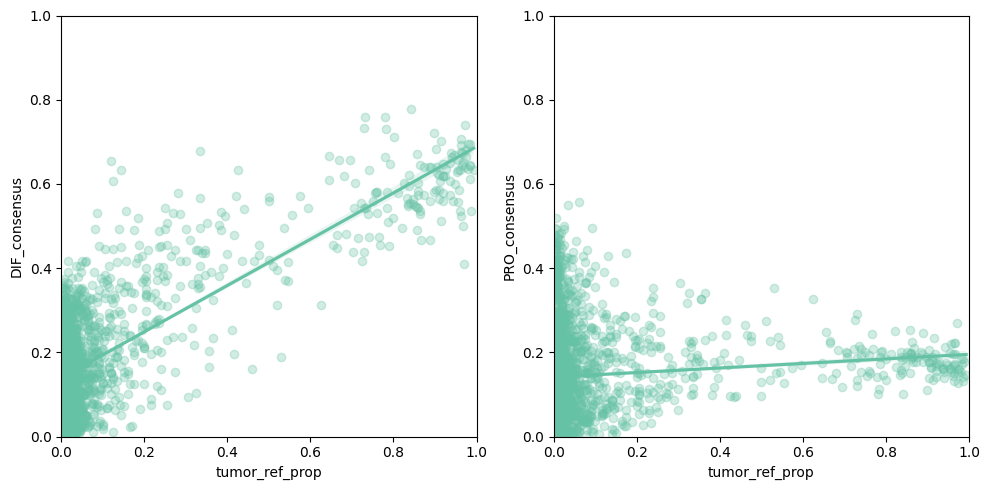

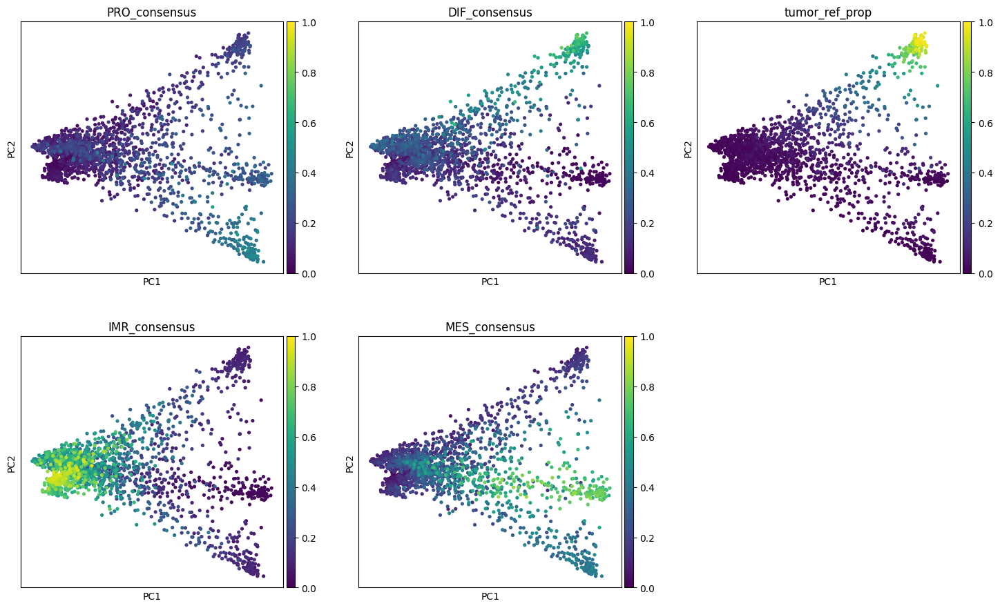

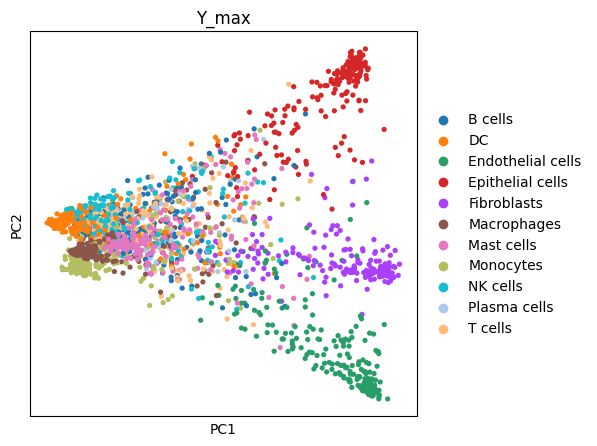

subtype,DIF,IMR,MES,PRO
subtype_total,,,,
DIF,266,1137,603,93
PRO,0,0,0,1


In [25]:
# MID


samp_id = "Samp_2467"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)



# get the proliferative where the 
cell_type_vec = np.array(mid_adata.obs.subtype)
cell_type_vec[np.where(mid_adata.obs.subtype.isin(["PRO", "IMR", "MES"]))] = "DIF"

idx = np.logical_and(mid_adata.obs.subtype == "PRO", mid_adata.obs.Y_max.isin(tumor_cell_ids))
pro_label_idx = np.where(idx)[0]
cell_type_vec[pro_label_idx] = "PRO"

mid_adata.obs['subtype_total'] = cell_type_vec

tab = mid_adata.obs.groupby(['subtype_total', 'subtype']).size()
tab.unstack()


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask paramete

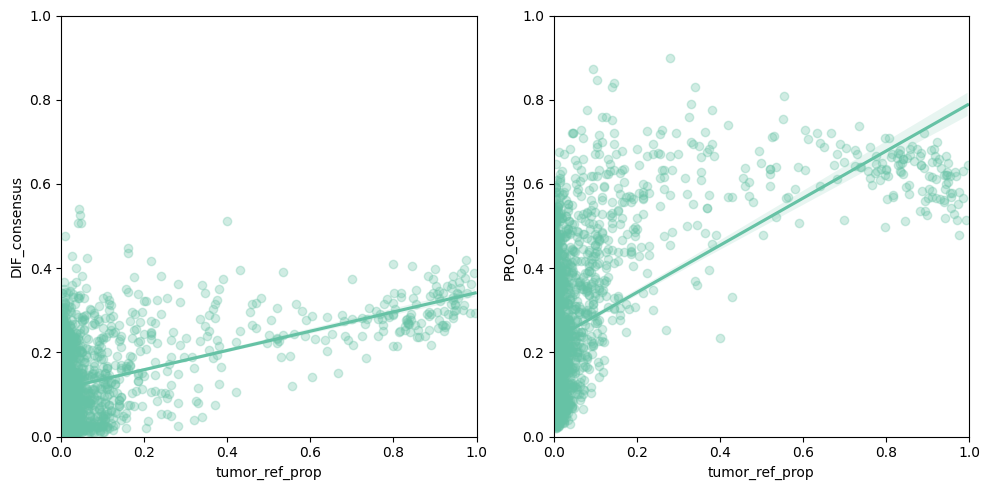

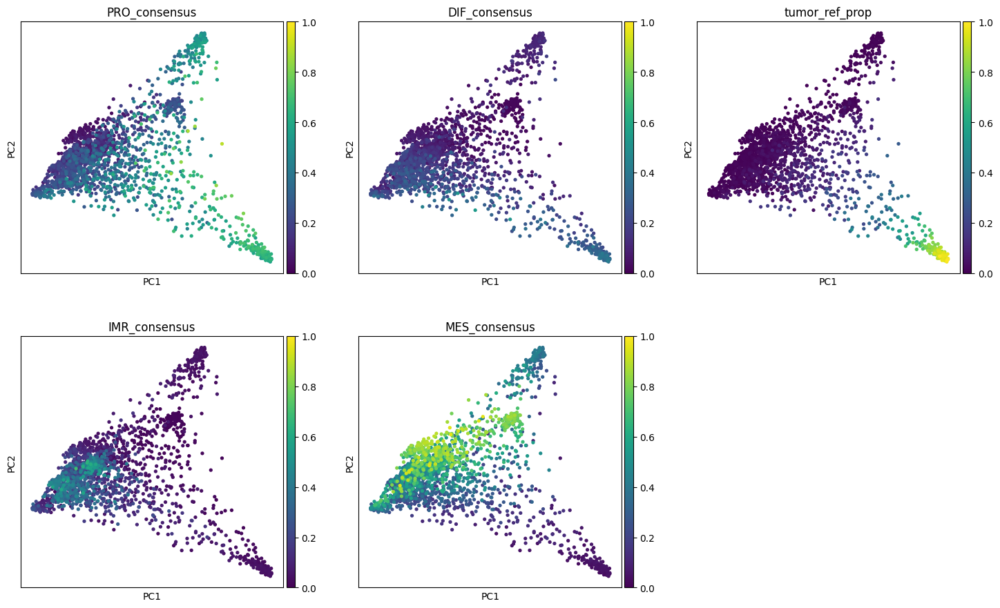

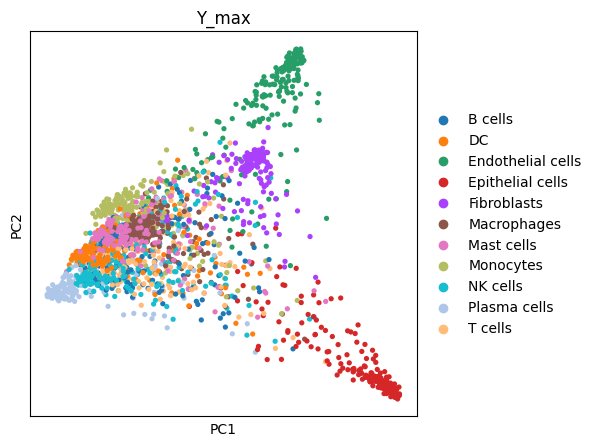

In [26]:
# PRO

samp_id = "Samp_2497"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)




In [27]:
# PRO?

samp_id = "Samp_2283"
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs = plot_scores_props_tumor(in_df=all_adata.obs, samp_id=samp_id, axs=axs)
fig.tight_layout()


idx = np.where(all_adata.obs.sample_id == samp_id)[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)


sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['PRO_consensus', 'DIF_consensus', 'tumor_ref_prop', 
                                 'IMR_consensus', 'MES_consensus'], ncols=3, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.pca(mid_adata, color=['Y_max'], ncols=3, vmin=0, vmax=1)




/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_utils.py:30: RuntimeWarning: Mean of empty slice.
  return X.mean(axis=axis, dtype=dtype)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: divide by zero encountered in divide

ValueError: Bin edges must be unique: array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan]).
You can drop duplicate edges by setting the 'duplicates' kwarg

In [86]:
np.unique(np.asarray(all_adata.obs.sample_id))

array(['SPECTRUM-OV-008_S1_LEFT_PARARENAL_LYMPH_NODE_WITH_COLONIC_MESENTARY',
       'SPECTRUM-OV-009_S1_BOWEL',
       'SPECTRUM-OV-024_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-036_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-036_S1_LEFT_ADNEXA',
       'SPECTRUM-OV-049_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-053_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-053_S1_LEFT_OVARY',
       'SPECTRUM-OV-053_S1_RIGHT_DIAPHRAGM',
       'SPECTRUM-OV-065_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-068_S1_LARGE_BOWEL',
       'SPECTRUM-OV-075_S1_LEFT_FALLOPIAN_TUBE',
       'SPECTRUM-OV-081_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-081_S1_RIGHT_ADNEXA',
       'SPECTRUM-OV-083_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-107_S1_BOWEL', 'SPECTRUM-OV-110_S1_BOWEL',
       'SPECTRUM-OV-110_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-115_S1_INFRACOLIC_OMENTUM',
       'SPECTRUM-OV-115_S1_LEFT_ADNEXA', 'Samp_2251', 'Samp_2293',
       'Samp_2380', 'Samp_2467', 'Samp_2497',
       'Samp_EOC1005_

In [98]:

train_ids = ["SPECTRUM-OV-065_S1_INFRACOLIC_OMENTUM", "Samp_2467", "Samp_EOC372_primary_Peritoneum", "SPECTRUM-OV-083_S1_INFRACOLIC_OMENTUM", 
             "Samp_2497", "Samp_EOC153_primary_Omentum"]
test_ids = ["ovCHA070", 'ovCHA110', "Samp_T89", 'Samp_T77',
            ] #"Samp_EOC3_interval_Omentum", 

#'ovCHA004', 'ovCHA017', 'ovCHA018', 'ovCHA034', 'ovCHA039',
#            'ovCHA066', 'ovCHA110'
all_ids = train_ids+test_ids

# proliferative samples
#"ovCHA070", "Samp_EOC372_primary_Peritoneum",
#"Samp_EOC153_primary_Omentum", "Samp_2497",
#"SPECTRUM-OV-083_S1_INFRACOLIC_OMENTUM",
#"SPECTRUM-OV-065_S1_INFRACOLIC_OMENTUM"

# differentiated samples
#"Samp_2467" "Samp_2251" Samp_EOC3_interval_Omentum Samp_T89

idx = np.where(all_adata.obs.sample_id.isin(all_ids))[0]
mid_adata = all_adata[idx]

# normalize to 10K counts per cell
sc.pp.normalize_total(mid_adata, target_sum=1e4)

# log data
sc.pp.log1p(mid_adata)

# get high variance genes
sc.pp.highly_variable_genes(mid_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

dif_marker_genes = ["SLPI", "LCN2", "FTH1", "RARRES1", "NNMT", "TNFRSF14",
                     "HLA-DRB5", "CD74", "GPX3", "PDZK1IP1"]
pro_marker_genes = ["MARCKSL1", "MFAP2", "UBE2S", "MEX3A", "SOX4",
                     "RTF1", "CHD7", "RCN2", "EIF3A", "ODC1", "WNT4"]
prev_genes = ["HOMER3", "FZD10", "FAM83A", "MYO18B", "MKX"]
keep_genes = dif_marker_genes+pro_marker_genes+prev_genes

mid_adata.var.highly_variable[np.where(mid_adata.var.index.isin(keep_genes))[0]] = True

mid_adata = mid_adata[:, mid_adata.var.highly_variable]

# scale the genes
sc.pp.scale(mid_adata)

print(mid_adata)


# get the proliferative where the tumor is major component
cell_type_vec = np.array(mid_adata.obs.subtype)
cell_type_vec[np.where(mid_adata.obs.subtype.isin(["PRO", "IMR", "MES"]))] = "DIF"

idx = np.logical_and(mid_adata.obs.subtype == "PRO", mid_adata.obs.Y_max.isin(tumor_cell_ids))
pro_label_idx = np.where(idx)[0]
cell_type_vec[pro_label_idx] = "PRO"

mid_adata.obs['subtype_total'] = cell_type_vec

tab = mid_adata.obs.groupby(['subtype_total', 'subtype']).size()
tab.unstack()


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
/tmp/ipykernel_1654764/795066616.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

AnnData object with n_obs × n_vars = 18200 × 4563
    obs: 'sample_id', 'stim', 'isTraining', 'cell_prop_type', 'samp_type', 'IMR_consensus', 'DIF_consensus', 'PRO_consensus', 'MES_consensus', 'subtype', 'Y_max', 'GSE_ID', 'tumor_ref_prop', 'immune_ref_prop', 'stromal_ref_prop', 'prop_max'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


subtype,DIF,IMR,MES,PRO
subtype_total,,,,
DIF,2257.0,6431.0,5370.0,2479.0
PRO,NaN,NaN,NaN,1663.0


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      1750
           1       0.94      0.93      0.94       290

    accuracy                           0.98      2040
   macro avg       0.97      0.96      0.96      2040
weighted avg       0.98      0.98      0.98      2040

0.9393414211438474
[[1734   16]
 [  19  271]]


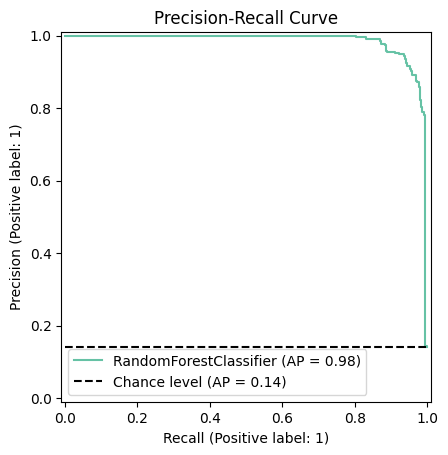

In [99]:
# predict proliferative tumor only
mapping = {"DIF": 0, "PRO": 1}

# get the proliferative where the tumor is major component
cell_type_vec = np.array(mid_adata.obs.subtype)
cell_type_vec[np.where(mid_adata.obs.subtype.isin(["PRO", "IMR", "MES"]))] = "DIF"

idx = np.logical_and(mid_adata.obs.subtype == "PRO", mid_adata.obs.Y_max.isin(tumor_cell_ids))
pro_label_idx = np.where(idx)[0]
cell_type_vec[pro_label_idx] = "PRO"

mid_adata.obs['subtype_total'] = cell_type_vec

tab = mid_adata.obs.groupby(['subtype_total', 'subtype']).size()
tab.unstack()

# set up variables and metadata
X_full = mid_adata.X
Y_full = mid_adata.obs['subtype_total']

# make Y numeric 
Y_num = Y_full.astype('category')
Y_num = np.array([mapping[x] for x in Y_num])

# hold out the samples of interest
X_val = X_full[mid_adata.obs.sample_id.isin(train_ids), :]
Y_val_num = Y_num[mid_adata.obs.sample_id.isin(train_ids)]



X_train, X_test, y_train, y_test = train_test_split(X_val, Y_val_num,
                                                    test_size=0.2,
                                                    random_state = 42,
                                                    stratify = Y_val_num)
len(X_train), len(X_test), len(y_train), len(y_test), set(y_test)

final_model = RandomForestClassifier(n_estimators=10, max_features=0.8, max_depth=7)
final_model.fit(X_train, y_train)

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

model_predict = final_model.predict(X_test)
print(classification_report(y_test, model_predict))
print(f1_score(y_test, model_predict, pos_label=1))
print(confusion_matrix(y_test, model_predict))

# Plot the precision-recall curve with baseline
display = PrecisionRecallDisplay.from_estimator(final_model, X_test, y_test, plot_chance_level=True)
_ = display.ax_.set_title("Precision-Recall Curve")
plt.show()

              precision    recall  f1-score   support

           0       0.99      0.97      0.98      7789
           1       0.45      0.79      0.58       211

    accuracy                           0.97      8000
   macro avg       0.72      0.88      0.78      8000
weighted avg       0.98      0.97      0.97      8000

[[7590  199]
 [  45  166]]


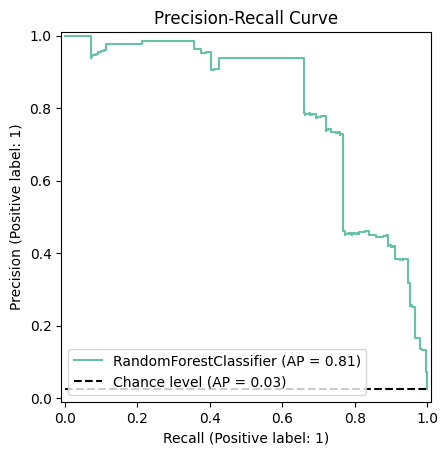

In [100]:
from sklearn.metrics import precision_recall_curve, auc
from sklearn.preprocessing import LabelEncoder

X_heldout = X_full[mid_adata.obs.sample_id.isin(test_ids), :]
Y_heldout_num = Y_num[mid_adata.obs.sample_id.isin(test_ids)]

model_predict = final_model.predict(X_heldout,)
print(classification_report(Y_heldout_num, model_predict))
print(confusion_matrix(Y_heldout_num, model_predict))


# Plot the precision-recall curve with baseline
display = PrecisionRecallDisplay.from_estimator(final_model, X_heldout, Y_heldout_num, plot_chance_level=True)
_ = display.ax_.set_title("Precision-Recall Curve")
plt.show()


In [102]:
np.unique(mid_adata.obs.sample_id.isin(test_ids))

array([False,  True])

In [103]:
samples_ids_heldout = mid_adata.obs.sample_id[mid_adata.obs.sample_id.isin(test_ids)]

In [104]:
mid_adata.obs.loc["7481"]

,sample_id,stim,isTraining,cell_prop_type,samp_type,IMR_consensus,DIF_consensus,PRO_consensus,MES_consensus,subtype,Y_max,GSE_ID,tumor_ref_prop,immune_ref_prop,stromal_ref_prop,prop_max,subtype_total
7481,Samp_T89,CTRL,Train,cell_type_specific,sc_ref,0.020,0.890,0.08,0.010,DIF,Epithelial cells,GSE154600,0.950768,0.002051,0.002334,tumor_DIF,DIF
7481,Samp_2467,CTRL,Train,cell_type_specific,sc_ref,0.338,0.324,0.12,0.218,IMR,B cells,GSE217517,0.006915,0.003757,0.001441,mid,DIF


In [105]:
y_scores = final_model.predict_proba(X_heldout)[:, 1]
test_samps = pd.DataFrame({'y_heldout': Y_heldout_num,
                           'y_prob': y_scores,
                           'samples_ids': samples_ids_heldout})
test_samps = test_samps.sort_values(by='y_prob', ascending=False)
test_samps

,y_heldout,y_prob,samples_ids
14039,1,0.896135,ovCHA070
14030,1,0.896134,ovCHA070
13863,1,0.895226,ovCHA070
13721,1,0.894351,ovCHA070
13904,1,0.894123,ovCHA070
...,...,...,...
6354,0,0.001374,Samp_T89
6953,0,0.001374,Samp_T89
2422,0,0.001322,ovCHA110
7480,0,0.001181,Samp_T89


In [107]:
# Get feature importances
importances = final_model.feature_importances_

# Create a DataFrame to store feature names and importances
feature_importances = pd.DataFrame({'feature': mid_adata.var.index.to_list(), 'importance': importances})

# Sort by importance in descending order
feature_importances = feature_importances.sort_values('importance', ascending=False)

feature_importances

,feature,importance
3030,PKP2,0.504743
2107,KIF1A,0.207303
3381,RFTN1,0.025767
1633,GPR183,0.018867
1200,EMX2OS,0.017452
...,...,...
1564,GIGYF2,0.000000
1563,GGT5,0.000000
1562,GGH,0.000000
1561,GGA2,0.000000


In [108]:
from sklearn.inspection import permutation_importance
result = permutation_importance(final_model, X_heldout, Y_heldout_num, n_repeats=10, random_state=0, n_jobs=-1)
perm_imp_df = pd.DataFrame({'Feature': mid_adata.var.index.to_list(), 'Permutation Importance': result.importances_mean}).sort_values('Permutation Importance', ascending=False)


In [109]:
perm_imp_df

,Feature,Permutation Importance
3030,PKP2,0.011663
3381,RFTN1,0.007000
2006,ISG20,0.005013
2107,KIF1A,0.001425
678,CDH2,0.001325
...,...,...
3562,SELL,-0.009375
2315,LPXN,-0.010312
2085,KCNMB2-AS1,-0.011712
1070,DNALI1,-0.013512


In [110]:

sc.tl.pca(mid_adata, n_comps=50)
sc.pp.neighbors(mid_adata)
sc.tl.umap(mid_adata)


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:210: UserWarning: When using a mask parameter with anndata<0.9 on a dense array, the PCAcan have slightly different results due the array being column major instead of row major.
  warnings.warn(
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/sklearn/manifold/_spectral_embedding.py:329: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


In [111]:
np.where(all_adata.var.index.isin(["HOMER3", "FZD10", "FAM83A", "MYO18B", "MKX"]))[0]

array([5086, 5574, 6580, 9202, 9663])

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_sub

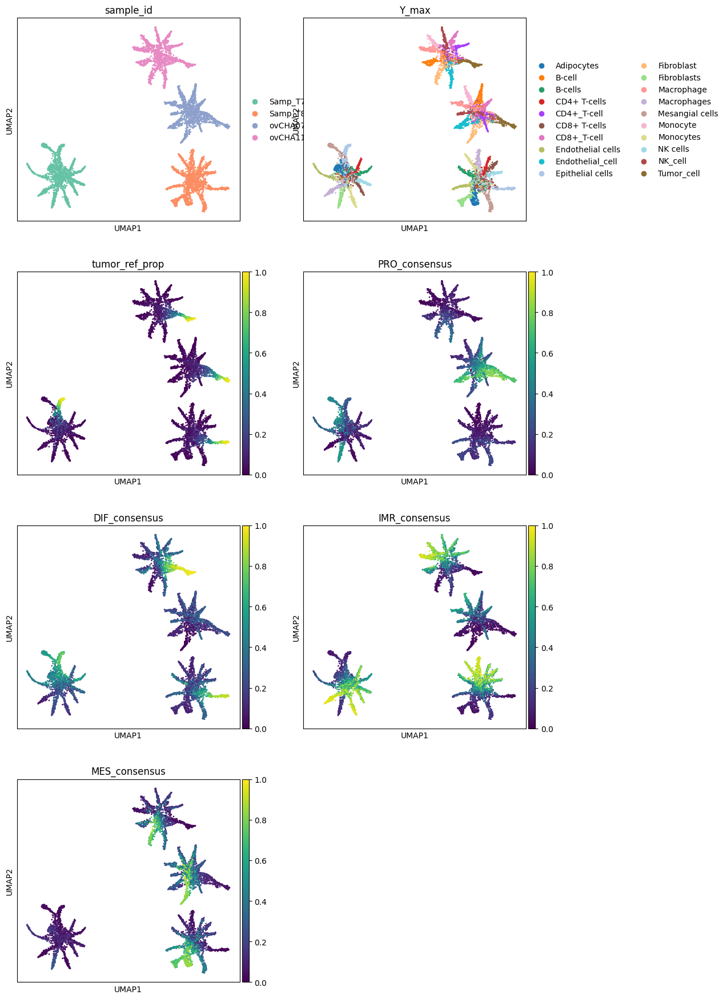

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_sub

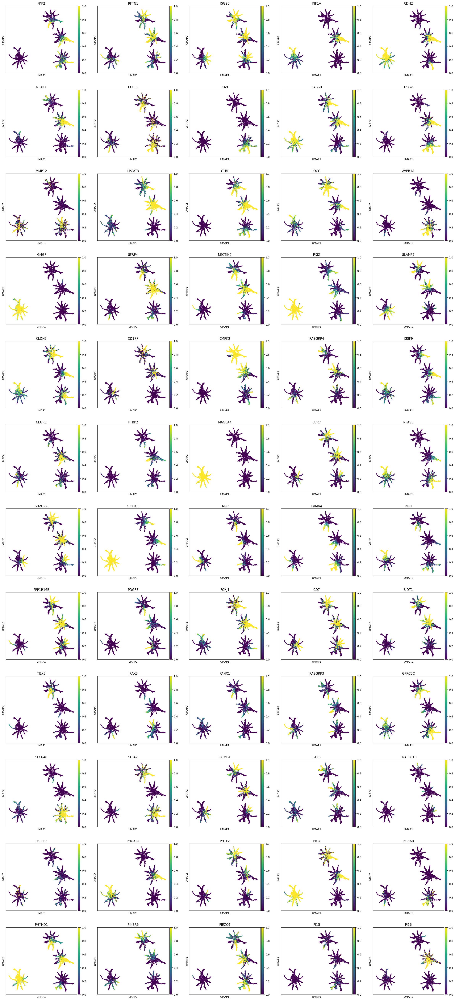

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_sub

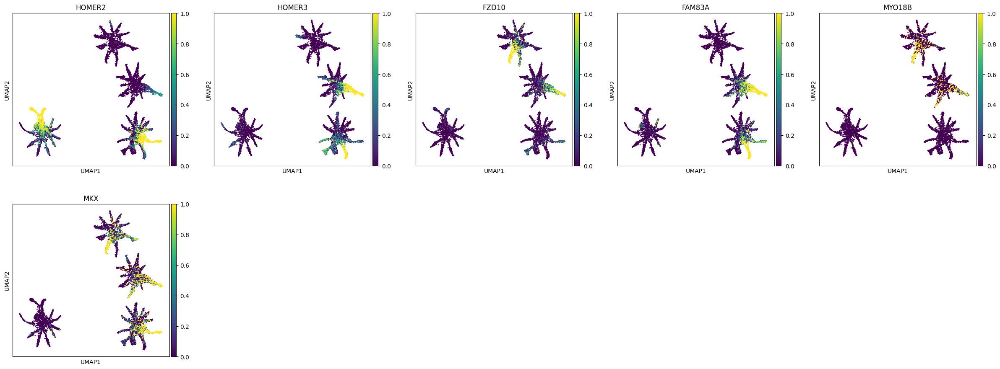

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_sub

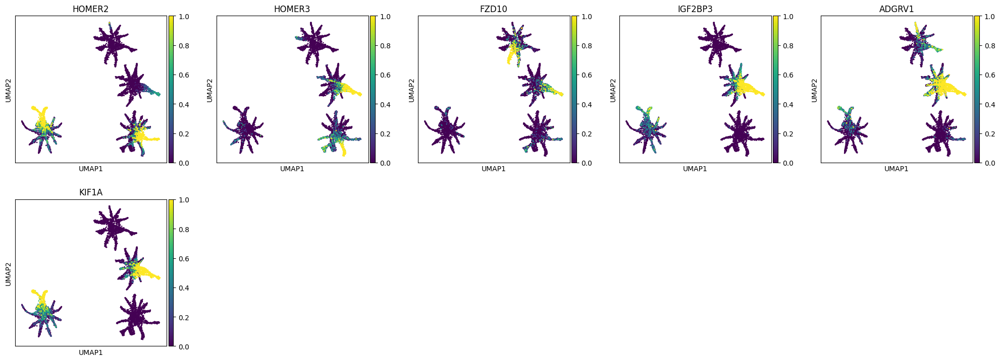

In [112]:

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(test_ids))[0]], 
              color=['sample_id', 'Y_max', 'tumor_ref_prop', 'PRO_consensus', 'DIF_consensus',  
                     'IMR_consensus', 'MES_consensus'], ncols=2, vmin=0, vmax=1)


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(test_ids))[0]], 
              color=perm_imp_df.Feature[0:60].to_list(), ncols=5, vmin=0, vmax=1)

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(test_ids))[0]], 
              color=["HOMER2", "HOMER3", "FZD10", "FAM83A", "MYO18B", "MKX"], ncols=5, vmin=0, vmax=1)


with rc_context({'figure.figsize': (4, 4)}):
    fig.tight_layout()
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(test_ids))[0]], 
              color=["HOMER2", "HOMER3", "FZD10", "IGF2BP3", "ADGRV1", "KIF1A"], ncols=5, vmin=0, vmax=1)


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

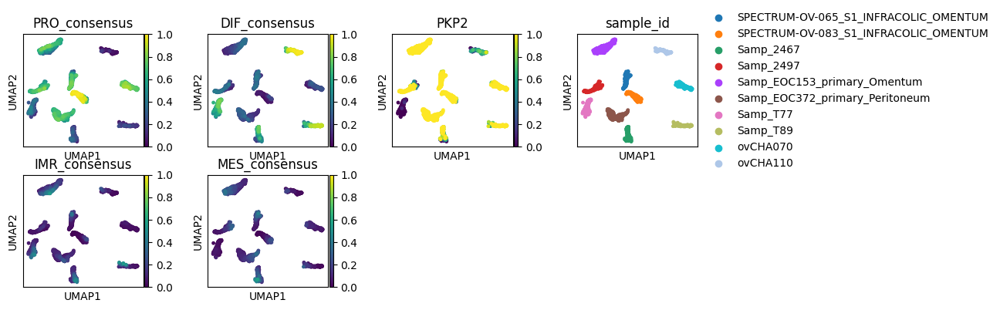

In [131]:
#IGF2BP3
with rc_context({'figure.figsize': (2, 2)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.Y_max.isin(tumor_cell_ids))[0]], 
              color=['PRO_consensus', 'DIF_consensus', "PKP2",
                     'sample_id', 'IMR_consensus', 'MES_consensus'], ncols=4, vmin=0, vmax=1)


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_sub

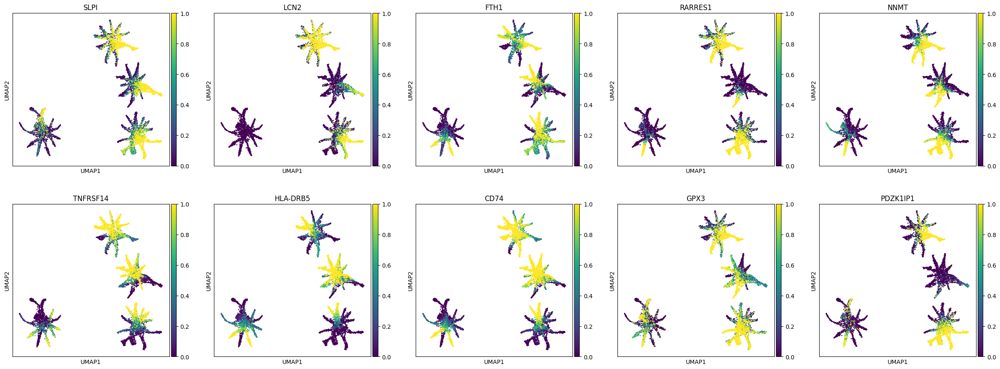

In [114]:



with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(test_ids))[0]], 
              color=dif_marker_genes, ncols=5, vmin=0, vmax=1)


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_sub

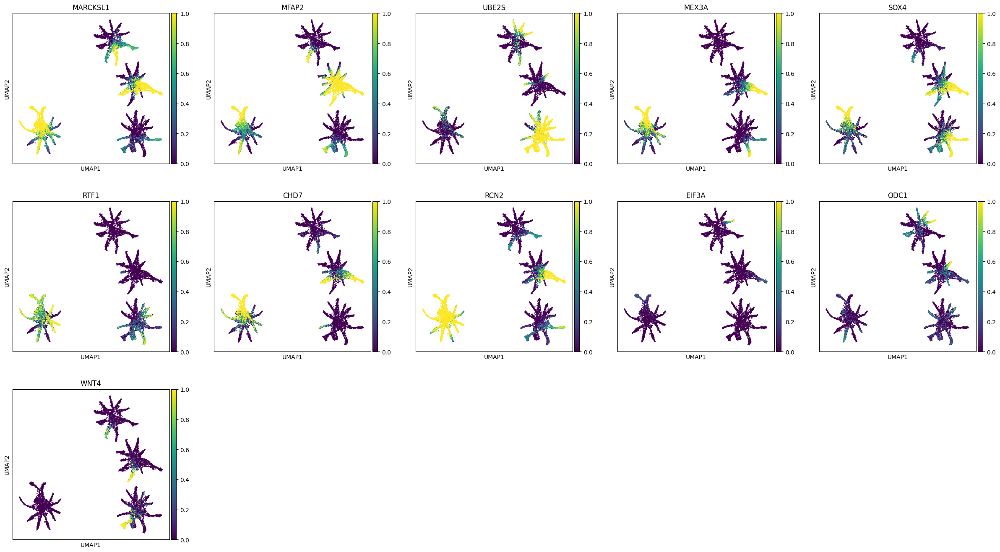

In [115]:


with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(test_ids))[0]], 
              color=pro_marker_genes, ncols=5, vmin=0, vmax=1)


In [141]:
tab = mid_adata.obs.groupby(['prop_max', 'Y_max']).size()
tab.unstack()

Y_max,Adipocytes,B cells,B-cell,B-cells,B.cell,CD4+ T-cells,CD4+_T-cell,CD8+ T-cells,CD8+_T-cell,DC,...,Monocytes,NK cells,NK_cell,Ovarian.cancer.cell,Plasma cells,Plasma.cell,Stromal,T cells,T.cell,Tumor_cell
prop_max,,,,,,,,,,,,,,,,,,,,,
immune,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,174.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mid,398.0,394.0,422.0,379.0,463.0,361.0,415.0,393.0,442.0,392.0,...,581.0,782.0,411.0,354.0,356.0,489.0,565.0,385.0,507.0,305.0
stromal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,328.0,NaN,NaN,NaN
tumor_DIF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,52.0
tumor_PRO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,134.0,NaN,NaN,NaN,NaN,NaN,48.0


In [140]:
tab = mid_adata.obs.groupby(['prop_max', 'subtype']).size()
tab.unstack()

subtype,DIF,IMR,MES,PRO
prop_max,,,,
immune,NaN,687.0,48.0,NaN
mid,2062.0,5744.0,4625.0,3534.0
stromal,NaN,NaN,697.0,57.0
tumor_DIF,195.0,NaN,NaN,NaN
tumor_PRO,NaN,NaN,NaN,551.0


/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

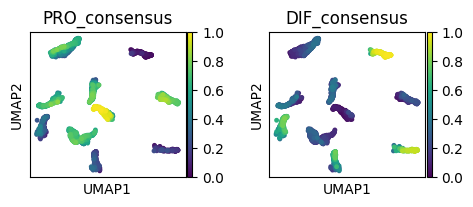

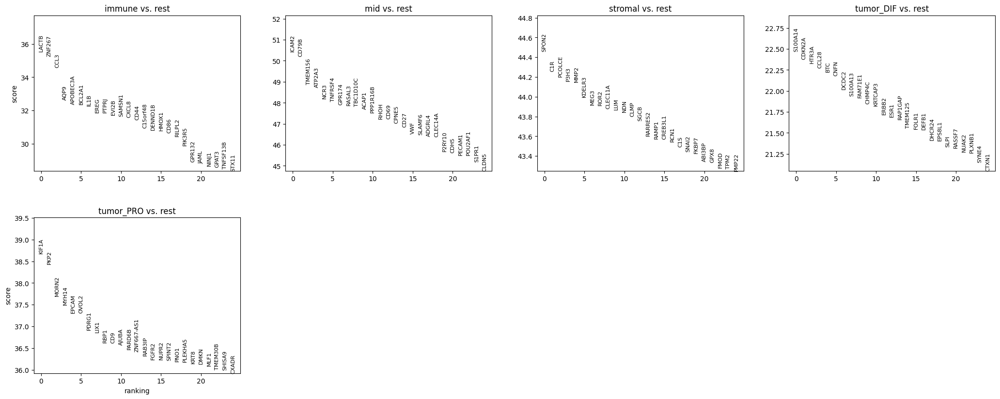

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

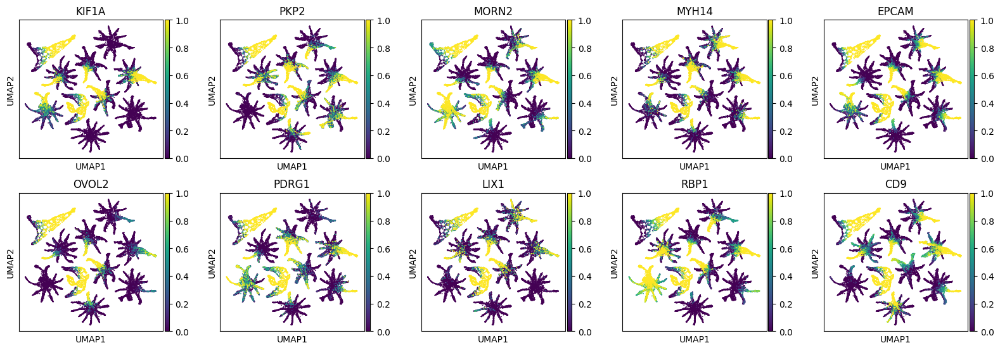

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

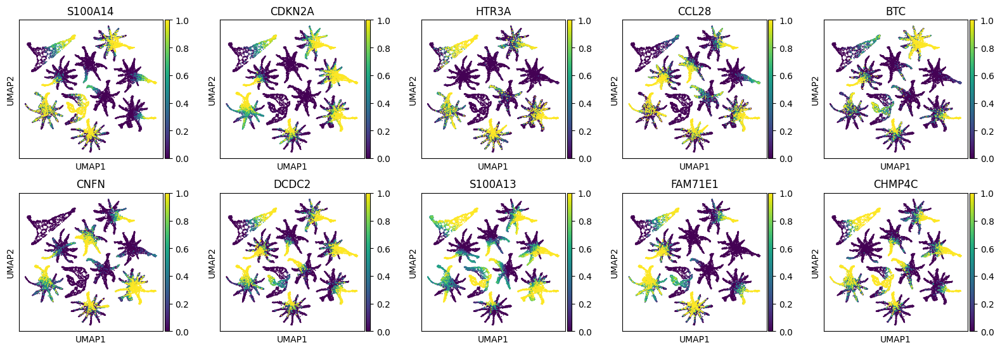

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

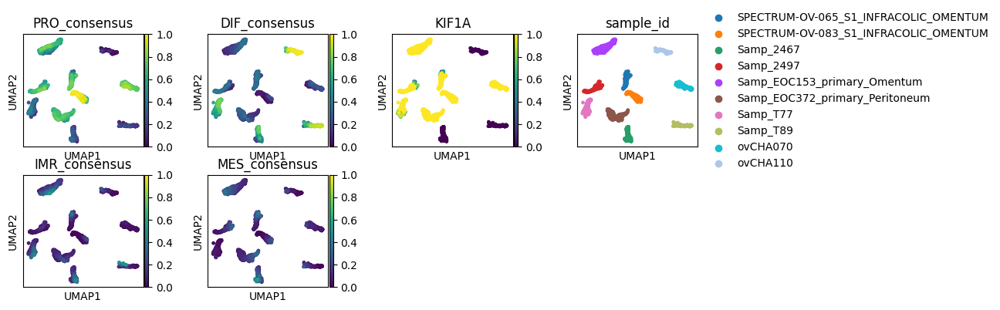

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

TypeError: unhashable type: 'Series'

In [ ]:
test_adata = mid_adata[np.where(mid_adata.obs.sample_id.isin(all_ids))[0]]
#test_adata = test_adata[np.where(test_adata.obs.Y_max.isin(tumor_cell_ids))[0]]

sc.tl.rank_genes_groups(test_adata, 'prop_max', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(test_adata, n_genes=25, sharey=False, key="wilcoxon")
test_adata_tumor1 = sc.get.rank_genes_groups_df(test_adata, group='tumor_PRO', key="wilcoxon") 
test_adata_tumor2 = sc.get.rank_genes_groups_df(test_adata, group='tumor_DIF', key="wilcoxon") 


with rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(all_ids))[0]], 
              color=test_adata_tumor1.names[0:10], ncols=5, vmin=0, vmax=1)


with rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.sample_id.isin(all_ids))[0]], 
              color=test_adata_tumor2.names[0:10], ncols=5, vmin=0, vmax=1)



/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

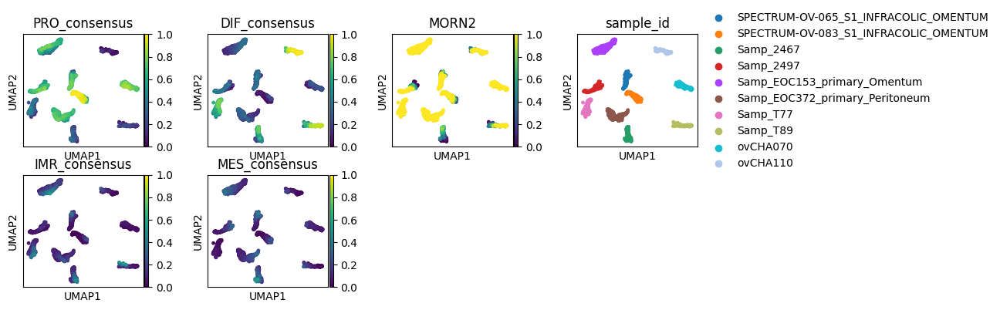

/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/var/projects/proportion_subtype_predictor/.prop_subtype_venv/lib/python3.12/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/proje

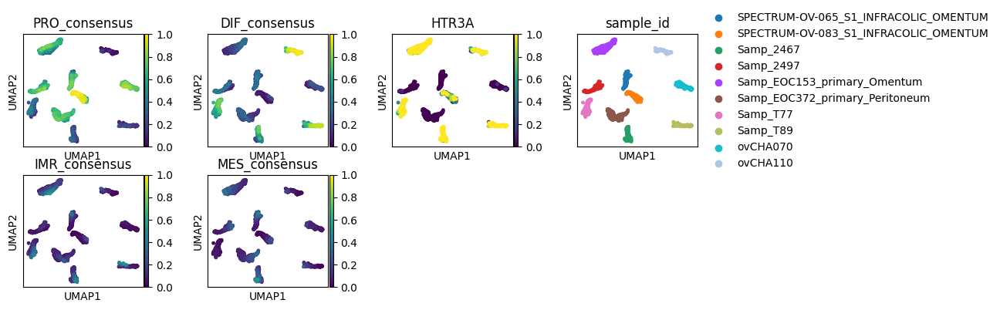

In [152]:
idx = 2
with rc_context({'figure.figsize': (2, 2)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.Y_max.isin(tumor_cell_ids))[0]], 
              color=['PRO_consensus', 'DIF_consensus', test_adata_tumor1.names[idx],
                     'sample_id', 'IMR_consensus', 'MES_consensus'], ncols=4, vmin=0, vmax=1)


with rc_context({'figure.figsize': (2, 2)}):
    sc.pl.umap(mid_adata[np.where(mid_adata.obs.Y_max.isin(tumor_cell_ids))[0]], 
              color=['PRO_consensus', 'DIF_consensus', test_adata_tumor2.names[idx],
                     'sample_id', 'IMR_consensus', 'MES_consensus'], ncols=4, vmin=0, vmax=1)
